# PROJECT 2

## Customer Segmentation using RFM Analysis

### I. DATA PREPROCESSING

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

> IMPORTING THE DATASET

In [2]:
data = pd.read_csv('data.csv')

In [3]:
#Displaying a few rows of data-
data.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/10 8:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/10 8:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/10 8:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/10 8:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/10 8:26,3.39,17850.0,United Kingdom


> DATA CLEANING

In [4]:
data.isnull().sum()

InvoiceNo           0
StockCode           0
Description      1454
Quantity            0
InvoiceDate         0
UnitPrice           0
CustomerID     135080
Country             0
dtype: int64

There are many null values in 2 columns - Description and CustomerID.

Handling the null values- 

In [5]:
data['Description'].fillna('Unknown', inplace=True)
data['Description'].isnull().sum()

0

In [6]:
data['CustomerID'] = data['CustomerID'].fillna( method = 'ffill')

In [7]:
data.isnull().sum()

InvoiceNo      0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
UnitPrice      0
CustomerID     0
Country        0
dtype: int64

Null values are handled.

> FORMATTING

checking if any data types needs to be converted-

In [8]:
data[['Date', 'Time']] = data['InvoiceDate'].str.split(expand=True)

In [9]:
data['Time']

0          8:26
1          8:26
2          8:26
3          8:26
4          8:26
          ...  
541904    12:50
541905    12:50
541906    12:50
541907    12:50
541908    12:50
Name: Time, Length: 541909, dtype: object

No changes needed here.

In [10]:
data['Date']

0         12/1/10
1         12/1/10
2         12/1/10
3         12/1/10
4         12/1/10
           ...   
541904    12/9/11
541905    12/9/11
541906    12/9/11
541907    12/9/11
541908    12/9/11
Name: Date, Length: 541909, dtype: object

Changing to YYYY-MM-DD format-

In [11]:
data['Date'] = pd.to_datetime(data['Date'])
data['Date']

0        2010-12-01
1        2010-12-01
2        2010-12-01
3        2010-12-01
4        2010-12-01
            ...    
541904   2011-12-09
541905   2011-12-09
541906   2011-12-09
541907   2011-12-09
541908   2011-12-09
Name: Date, Length: 541909, dtype: datetime64[ns]

Data Preprocessing is completed. 

### II. RFM CALCULATION

> Calculating Recency - 

In [12]:
max_date = data['Date'].max()  
data['Recency'] = (max_date - data['Date']).dt.days 

In [13]:
data['Recency']

0         373
1         373
2         373
3         373
4         373
         ... 
541904      0
541905      0
541906      0
541907      0
541908      0
Name: Recency, Length: 541909, dtype: int64

> Calculating Frequency -

In [14]:
frequency = data.groupby('CustomerID')['InvoiceNo'].nunique().reset_index()
frequency.columns = ['CustomerID', 'Frequency'] 

In [15]:
frequency

,CustomerID,Frequency
0,12346.0,2
1,12347.0,7
2,12348.0,5
3,12349.0,1
4,12350.0,1
...,...,...
4367,18280.0,6
4368,18281.0,1
4369,18282.0,3
4370,18283.0,16


> Calculating Monetary-

In [16]:
data['TotalPrice'] = data['Quantity'] * data['UnitPrice']  # Calculate total price per transaction
monetary = data.groupby('CustomerID')['TotalPrice'].sum().reset_index()
monetary.columns = ['CustomerID', 'Monetary']

In [17]:
monetary

,CustomerID,Monetary
0,12346.0,0.00
1,12347.0,4310.00
2,12348.0,3366.27
3,12349.0,1757.55
4,12350.0,334.40
...,...,...
4367,18280.0,8330.57
4368,18281.0,80.82
4369,18282.0,176.60
4370,18283.0,2094.88


In [18]:
rfm = pd.merge(frequency, monetary, on='CustomerID')
rfm = pd.merge(rfm, data[['CustomerID', 'Recency']].drop_duplicates(), on='CustomerID')

> RFM data frame- 

In [19]:
rfm

,CustomerID,Frequency,Monetary,Recency
0,12346.0,2,0.00,325
1,12347.0,7,4310.00,367
2,12347.0,7,4310.00,317
3,12347.0,7,4310.00,246
4,12347.0,7,4310.00,183
...,...,...,...,...
19300,18283.0,16,2094.88,9
19301,18283.0,16,2094.88,3
19302,18287.0,3,1837.28,201
19303,18287.0,3,1837.28,58


### III. RFM SEGMENTATION

Using quartiles- 

In [20]:
rfm['RecencyScore'] = pd.qcut(rfm['Recency'], q=4, labels=range(4, 0, -1))
rfm['FrequencyScore'] = pd.qcut(rfm['Frequency'], q=4, labels=range(1, 5))
rfm['MonetaryScore'] = pd.qcut(rfm['Monetary'], q=4, labels=range(1, 5))

In [21]:
rfm['RecencyScore'] = rfm['RecencyScore'].astype(int)
rfm['FrequencyScore'] = rfm['FrequencyScore'].astype(int)
rfm['MonetaryScore'] = rfm['MonetaryScore'].astype(int)

Calculating the score-

In [22]:
rfm['RFMScore'] = rfm['RecencyScore'] + rfm['FrequencyScore'] + rfm['MonetaryScore']

In [23]:
rfm

,CustomerID,Frequency,Monetary,Recency,RecencyScore,FrequencyScore,MonetaryScore,RFMScore
0,12346.0,2,0.00,325,1,1,1,3
1,12347.0,7,4310.00,367,1,2,3,6
2,12347.0,7,4310.00,317,1,2,3,6
3,12347.0,7,4310.00,246,2,2,3,7
4,12347.0,7,4310.00,183,2,2,3,7
...,...,...,...,...,...,...,...,...
19300,18283.0,16,2094.88,9,4,3,2,9
19301,18283.0,16,2094.88,3,4,3,2,9
19302,18287.0,3,1837.28,201,2,1,2,5
19303,18287.0,3,1837.28,58,4,1,2,7


### IV. CUSTOMER SEGMENTATION

In [24]:
X = rfm[['RecencyScore', 'FrequencyScore', 'MonetaryScore']]

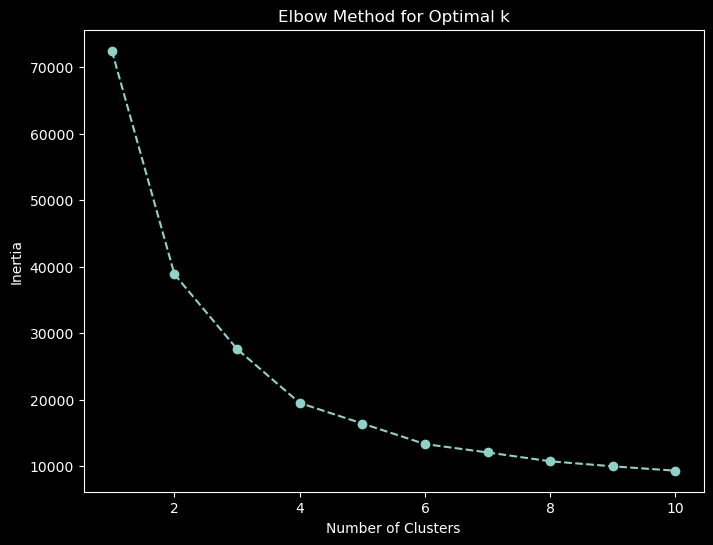

In [25]:
inertia = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
    kmeans.fit(X)
    inertia.append(kmeans.inertia_)

plt.style.use('dark_background')
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), inertia, marker='o', linestyle='--')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.show()

From the Elbow method, the optimal number of clusers is 6

In [26]:
kmeans = KMeans(n_clusters=6, n_init=10, random_state=42)  
kmeans.fit(X)
rfm['Cluster'] = kmeans.labels_
print(rfm.head())

   CustomerID  Frequency  Monetary  Recency  RecencyScore  FrequencyScore  \
0     12346.0          2       0.0      325             1               1   
1     12347.0          7    4310.0      367             1               2   
2     12347.0          7    4310.0      317             1               2   
3     12347.0          7    4310.0      246             2               2   
4     12347.0          7    4310.0      183             2               2   

   MonetaryScore  RFMScore  Cluster  
0              1         3        4  
1              3         6        2  
2              3         6        2  
3              3         7        2  
4              3         7        2  


In [27]:
rfm

,CustomerID,Frequency,Monetary,Recency,RecencyScore,FrequencyScore,MonetaryScore,RFMScore,Cluster
0,12346.0,2,0.00,325,1,1,1,3,4
1,12347.0,7,4310.00,367,1,2,3,6,2
2,12347.0,7,4310.00,317,1,2,3,6,2
3,12347.0,7,4310.00,246,2,2,3,7,2
4,12347.0,7,4310.00,183,2,2,3,7,2
...,...,...,...,...,...,...,...,...,...
19300,18283.0,16,2094.88,9,4,3,2,9,5
19301,18283.0,16,2094.88,3,4,3,2,9,5
19302,18287.0,3,1837.28,201,2,1,2,5,4
19303,18287.0,3,1837.28,58,4,1,2,7,1


### V. SEGMENT PROFILING

In [28]:
segment_profiles = rfm.groupby('Cluster').agg({
    'Recency': 'mean',       
    'Frequency': 'mean',     
    'Monetary': 'mean',      
}).reset_index()

segment_profiles.rename(columns={'Cluster': 'Segment'}, inplace=True)

print(segment_profiles)

   Segment     Recency  Frequency      Monetary
0        0  262.507607  57.863071  27742.172801
1        1   60.830386   2.984283    608.319043
2        2  258.112774  11.153443   3031.899866
3        3   68.897812  43.802317  21316.296412
4        4  262.752304   3.177295    530.321324
5        5   65.426444   8.369778   2332.801885


#### SEGMENT PROFILING:

RFM Analysis:

1. Recency: Mean recency values for each segment indicate how recently customers made purchases. Lower values signify more recent purchases.

2. Frequency (F): Mean or median frequency values demonstrate how often customers from each segment make purchases. Higher values indicate more frequent buyers.

3. Monetary (M): Mean or median monetary values represent the average spending of customers within each segment. Higher values indicate higher-spending customers.


#### Segment 0:

- Recency (R): Around 69 days since last purchase.
- Frequency (F): High frequency, averaging 44 orders.
- Monetary (M): High monetary value, spending about $21,287 on average.
- Profile: Engaged and high-spending customers who make frequent purchases.

#### Segment 1:

- Recency (R): Approximately 61 days since last purchase.
- Frequency (F): Low frequency, averaging around 3 orders.
- Monetary (M): Lower monetary value, spending about $608 on average.
- Profile: Customers who make fewer purchases, less engaged, and with lower spending.

#### Segment 2:

- Recency (R): Higher recency, about 258 days since last purchase.
- Frequency (F): Moderate frequency, averaging around 11 orders.
- Monetary (M): Moderate monetary value, spending about $3,033 on average.
- Profile: Customers with moderate engagement and spending, but less recent activity.

#### Segment 3:

- Recency (R): Approximately 65 days since last purchase.
- Frequency (F): Moderate frequency, averaging about 8 orders.
- Monetary (M): Moderate monetary value, spending around $2,333 on average.
- Profile: Moderately engaged customers with moderate spending patterns.

#### Segment 4:

- Recency (R): High recency, around 263 days since last purchase.
- Frequency (F): Low frequency, averaging about 3 orders.
- Monetary (M): Lower monetary value, spending approximately $530 on average.
- Profile: Customers who make infrequent purchases and exhibit low spending habits.

#### Segment 5:

- Recency (R): Higher recency, about 262 days since last purchase.
- Frequency (F): High frequency, averaging 58 orders.
- Monetary (M): High monetary value, spending approximately $27,747 on average.
- Profile: Engaged and high-spending customers with frequent purchase behavior.

### VI. MARKETING RECOMMENDATIONS


#### Segment 0: Engaged High-Spending Customers
##### Recommendations:
- VIP Treatment: Offer exclusive perks, early access, or VIP rewards to maintain loyalty.
- Personalized Offers: Create personalized bundles, discounts, or promotions based on their preferences and purchase history.
- Loyalty Programs: Implement tiered loyalty programs to encourage repeat purchases and increase engagement.
- Upselling/Cross-selling: Suggest complementary high-value products to increase the average order value.

#### Segment 1: Low-Engagement, Low-Spending Customers
##### Recommendations:
- Re-engagement Campaigns: Send targeted campaigns with incentives or discounts to encourage revisits.
- Personalized Recommendations: Recommend products based on past purchases to spark interest.
- Improve Customer Experience: Enhance user experience, ease of ordering, or customer service to improve satisfaction and retention.

#### Segment 2: Moderately Engaged, Moderate Spending
##### Recommendations:
- Reactivation Campaigns: Target customers with personalized incentives to re-engage.
- Showcase Value: Highlight unique features, benefits, or promotions to encourage more frequent purchases.
- Loyalty Incentives: Offer loyalty rewards or discounts on subsequent purchases.

#### Segment 3: Moderate Engagement, Moderate Spending
##### Recommendations:
- Tailored Promotions: Send personalized promotions based on past behavior to encourage increased spending.
- Loyalty Rewards: Encourage loyalty with rewards or points for continued engagement.
- Product Education: Share educational content or tips related to their purchases to enhance engagement.

#### Segment 4: Low-Engagement, Low-Spending
##### Recommendations:
- Win-Back Campaigns: Target with compelling offers to regain their interest.
- Incentivize Purchases: Offer discounts or incentives to increase order frequency.
- Referral Programs: Encourage referrals by offering benefits for recommending products to others.

#### Segment 5: Engaged High-Frequency, High-Spending Customers
##### Recommendations:
- Exclusive Access: Provide early access to new products, services, or events to maintain engagement.
- Reward Loyalty: Offer special rewards or benefits for continued loyalty and high spending.
- Personalized Engagement: Tailor communications and offers based on past interactions to enhance satisfaction and retention.


### VISUALIZATION

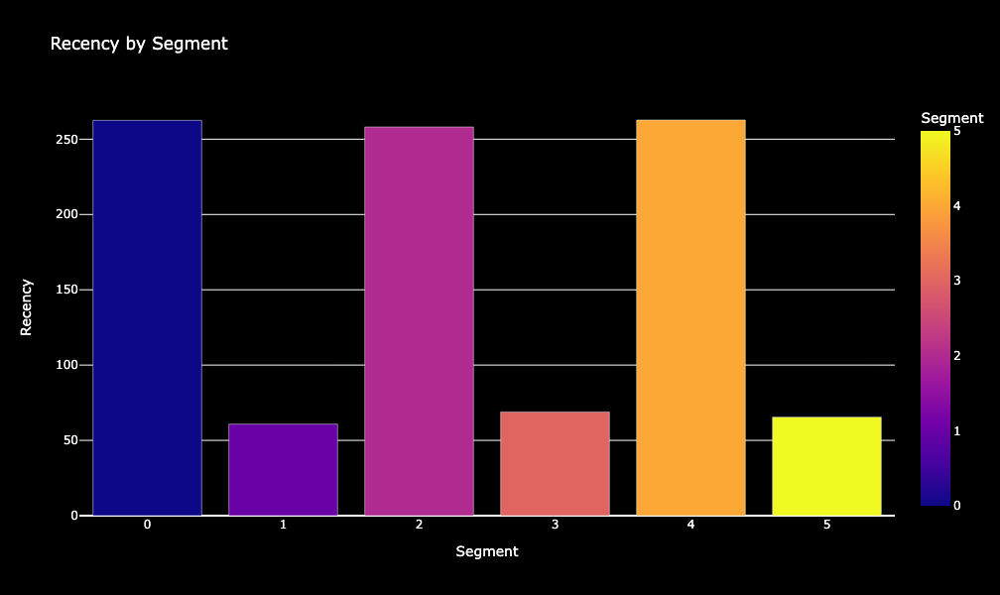

In [29]:
import plotly.express as px

fig = px.bar(segment_profiles, x='Segment', y='Recency', color='Segment', title='Recency by Segment')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()


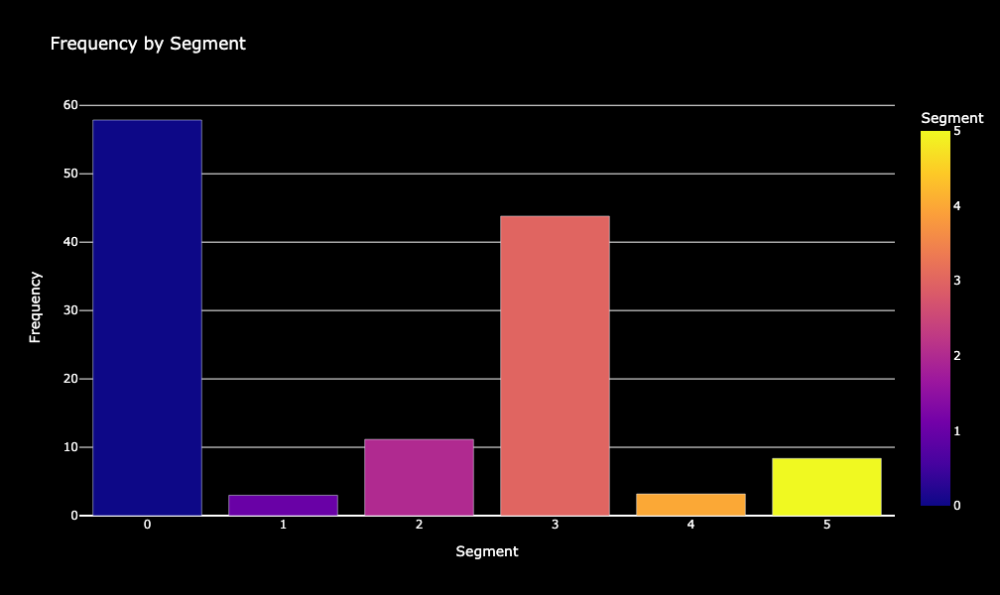

In [30]:
fig = px.bar(segment_profiles, x='Segment', y='Frequency', color='Segment', title='Frequency by Segment')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()

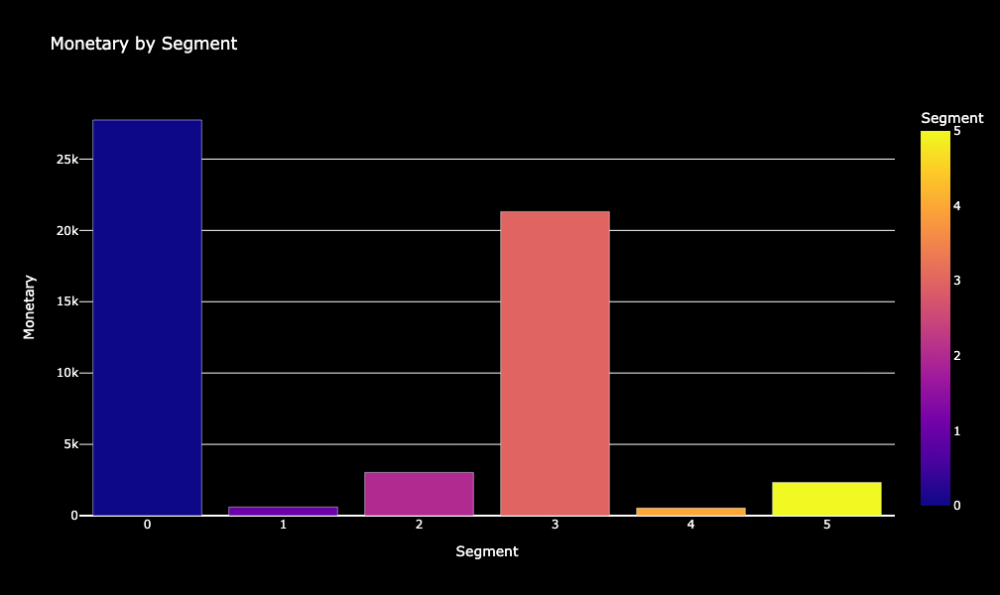

In [31]:
fig = px.bar(segment_profiles, x='Segment', y='Monetary', color='Segment', title='Monetary by Segment')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()

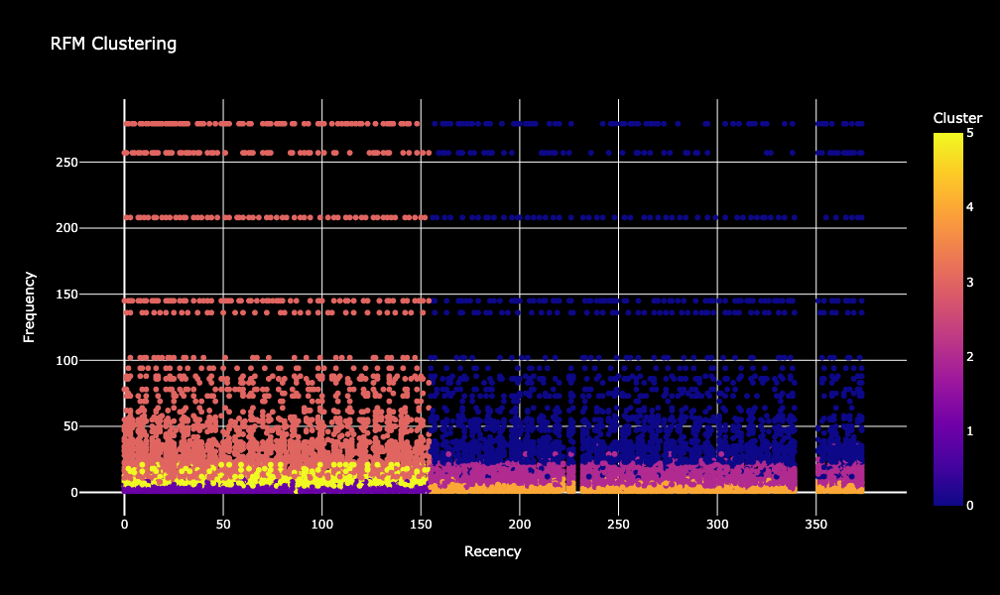

In [32]:
fig = px.scatter(rfm, x='Recency', y='Frequency' , color='Cluster', title='RFM Clustering')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()


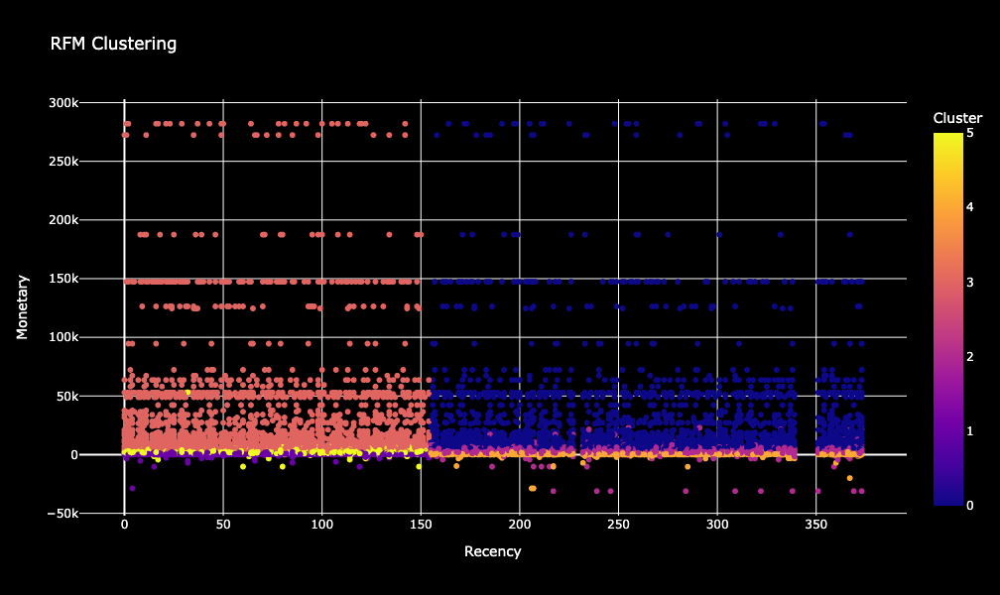

In [33]:
fig = px.scatter(rfm, x='Recency', y='Monetary' , color='Cluster', title='RFM Clustering')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()


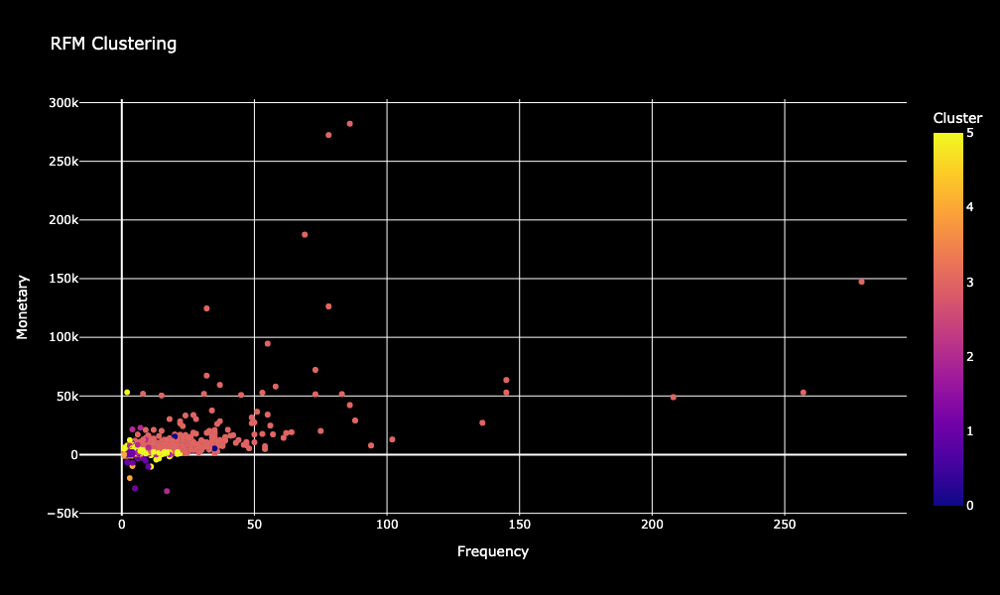

In [34]:
fig = px.scatter(rfm, x='Frequency', y='Monetary' , color='Cluster', title='RFM Clustering')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()


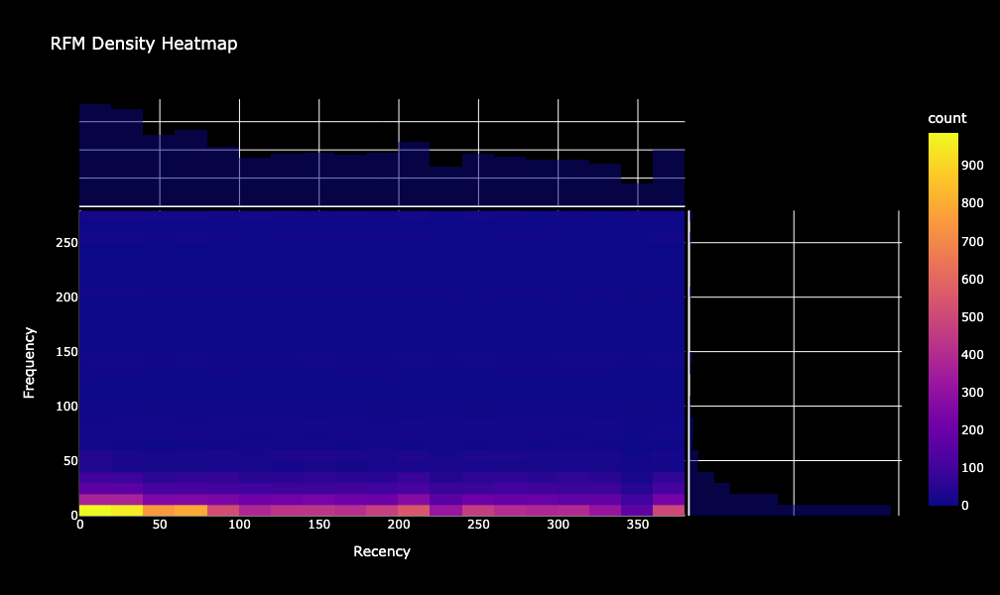

In [35]:
fig = px.density_heatmap(rfm, x='Recency', y='Frequency', marginal_x='histogram', marginal_y='histogram', title='RFM Density Heatmap')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()


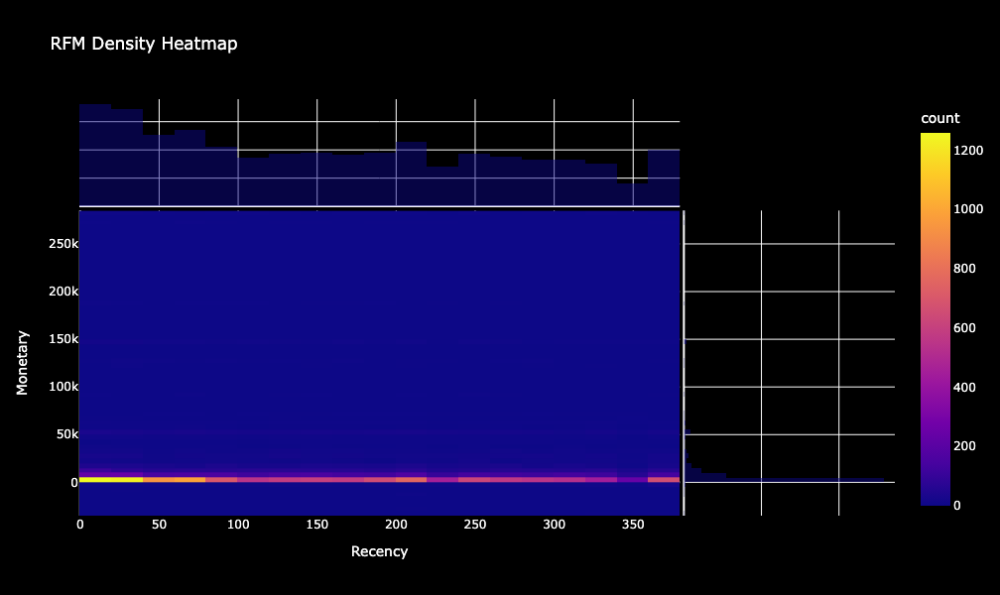

In [36]:
fig = px.density_heatmap(rfm, x='Recency', y='Monetary', marginal_x='histogram', marginal_y='histogram', title='RFM Density Heatmap')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()


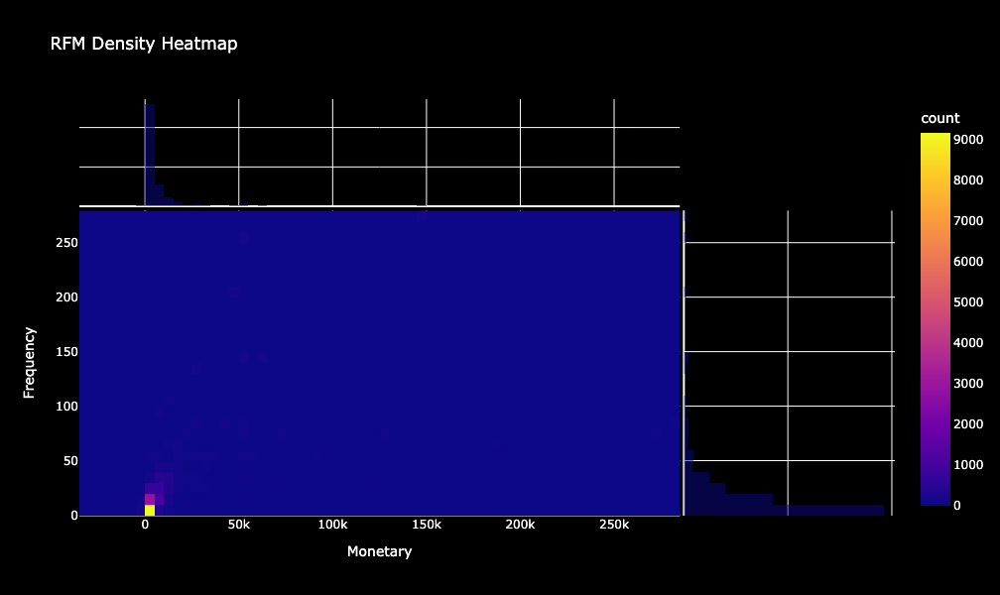

In [37]:
fig = px.density_heatmap(rfm, x='Monetary', y='Frequency', marginal_x='histogram', marginal_y='histogram', title='RFM Density Heatmap')
fig.update_layout(width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()


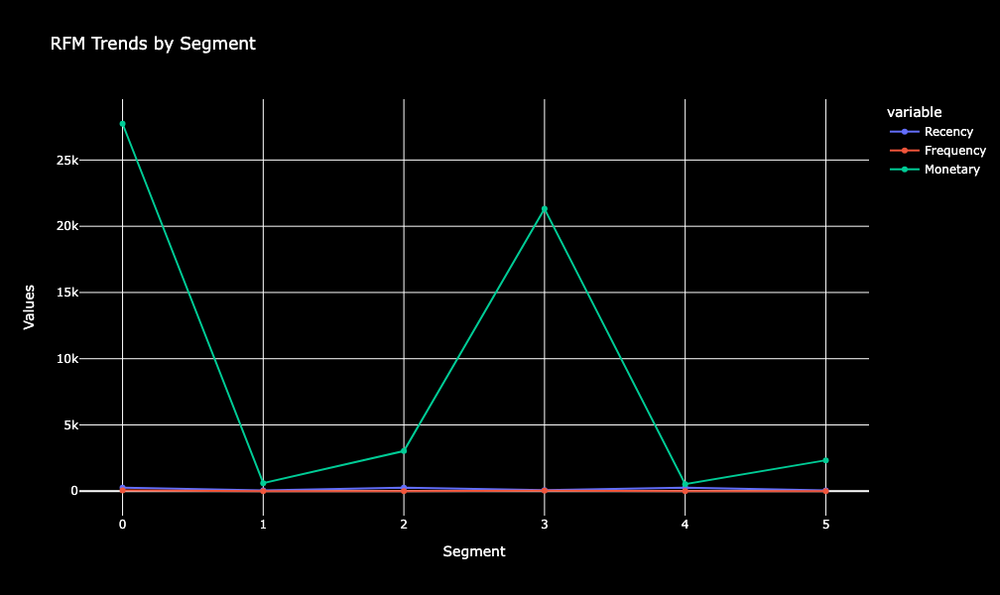

In [38]:
fig = px.line(segment_profiles, x='Segment', y=['Recency', 'Frequency', 'Monetary'], title='RFM Trends by Segment')
fig.update_traces(mode='lines+markers')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white'),
    xaxis=dict(type='category'),
    yaxis=dict(title='Values')
)
fig.show()


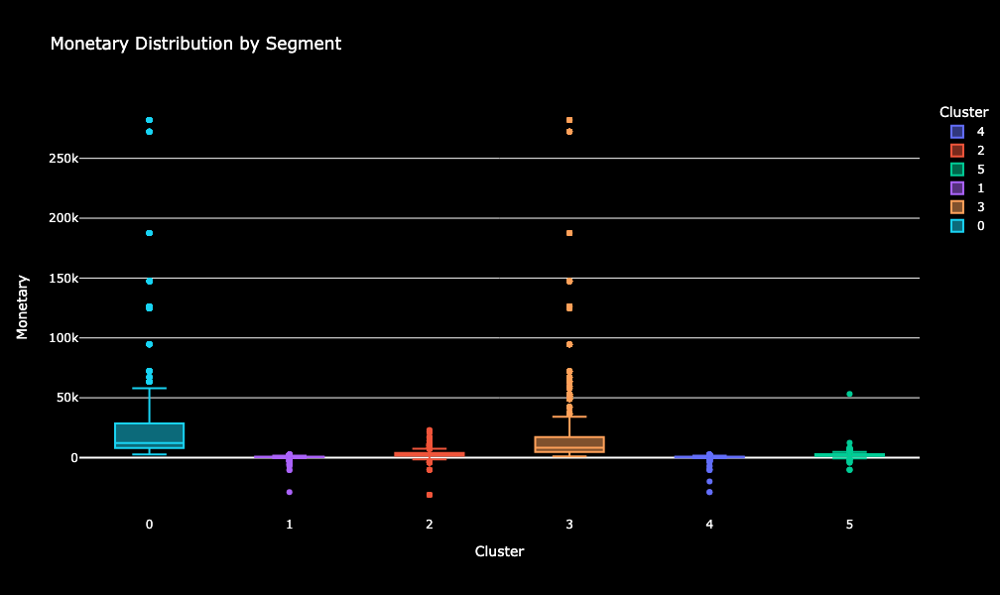

In [39]:
fig = px.box(rfm, x='Cluster', y='Monetary', color='Cluster', title='Monetary Distribution by Segment')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()


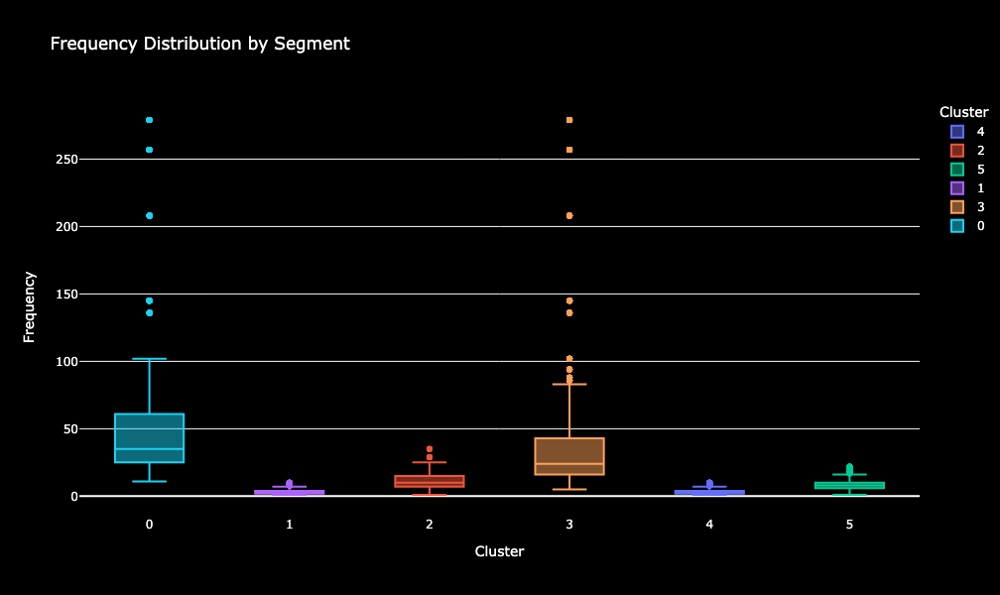

In [40]:
fig = px.box(rfm, x='Cluster', y='Frequency', color='Cluster', title='Frequency Distribution by Segment')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()


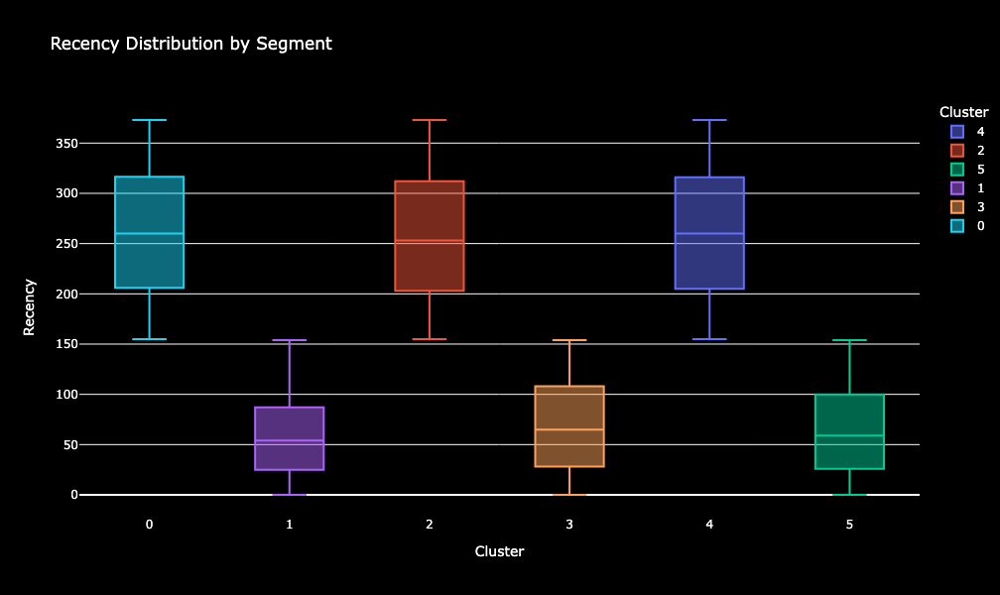

In [41]:
fig = px.box(rfm, x='Cluster', y='Recency', color='Cluster', title='Recency Distribution by Segment')
fig.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig.show()


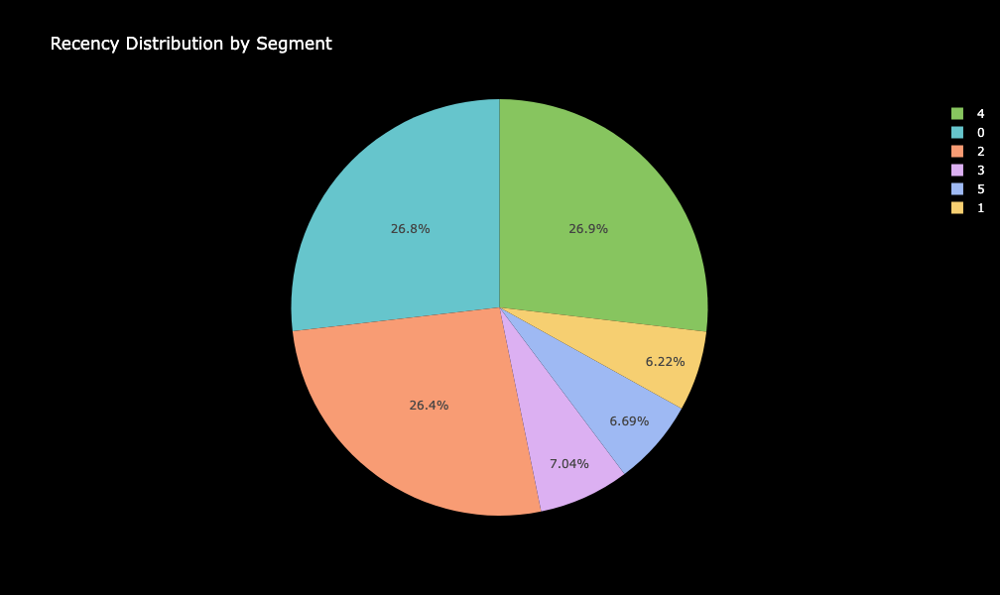

In [42]:
fig_recency = px.pie(segment_profiles, names='Segment', values='Recency', title='Recency Distribution by Segment')
fig_recency.update_traces(marker=dict(colors=px.colors.qualitative.Pastel))
fig_recency.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig_recency.show()


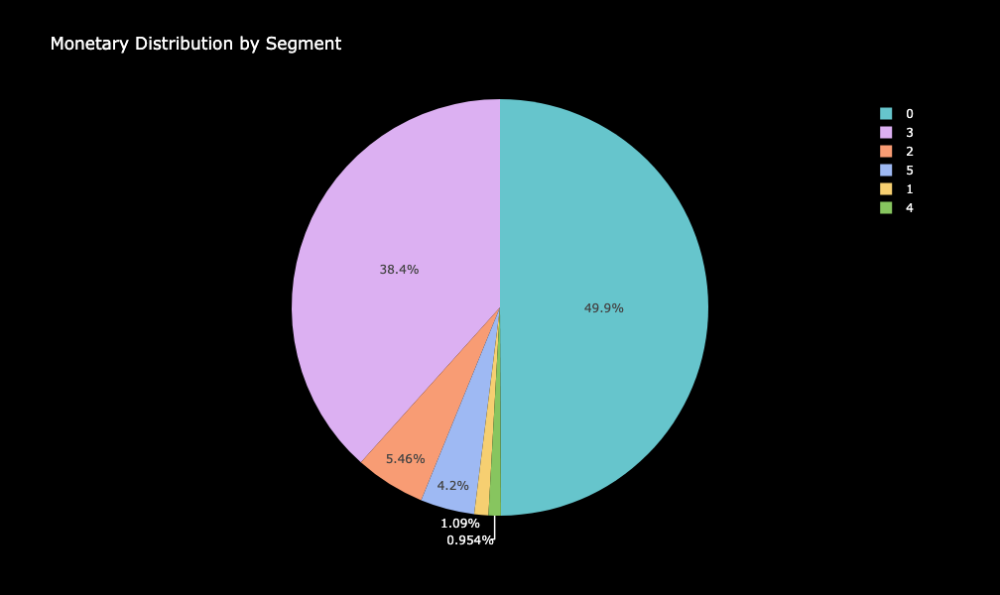

In [43]:
fig_monetary = px.pie(segment_profiles, names='Segment', values='Monetary', title='Monetary Distribution by Segment')
fig_monetary.update_traces(marker=dict(colors=px.colors.qualitative.Pastel))
fig_monetary.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig_monetary.show()

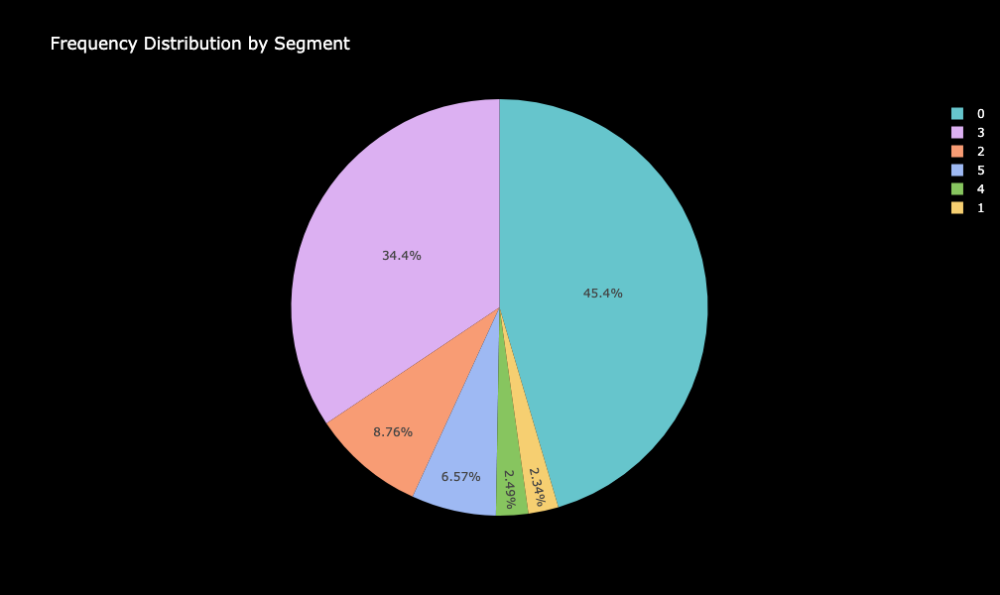

In [44]:
fig_frequency = px.pie(segment_profiles, names='Segment', values='Frequency', title='Frequency Distribution by Segment')
fig_frequency.update_traces(marker=dict(colors=px.colors.qualitative.Pastel))
fig_frequency.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig_frequency.show()

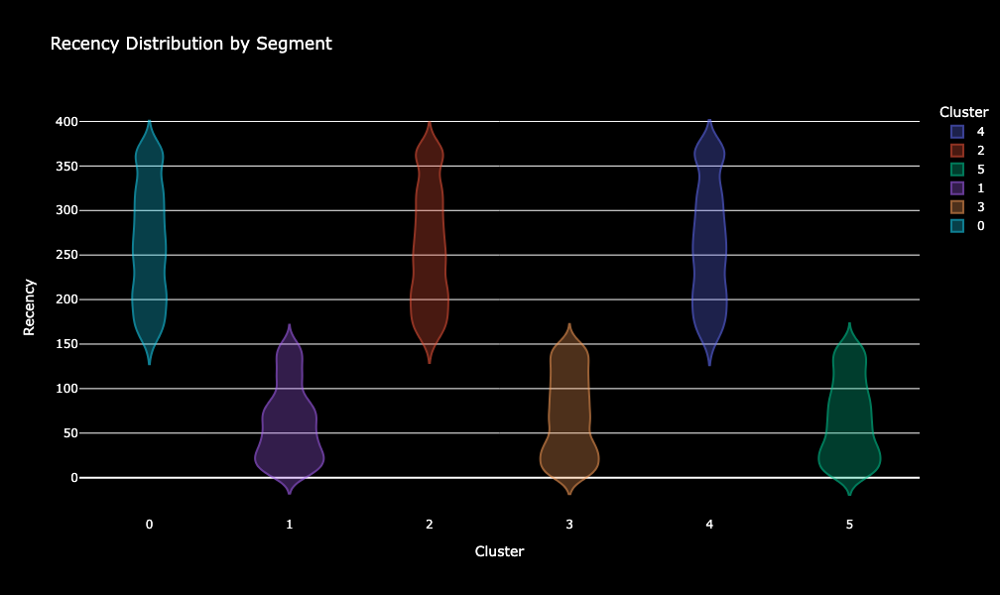

In [45]:
fig_recency_violin = px.violin(rfm, x='Cluster', y='Recency', color='Cluster', title='Recency Distribution by Segment')
fig_recency_violin.update_traces(marker=dict(line=dict(color='black')), opacity=0.6)
fig_recency_violin.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig_recency_violin.show()


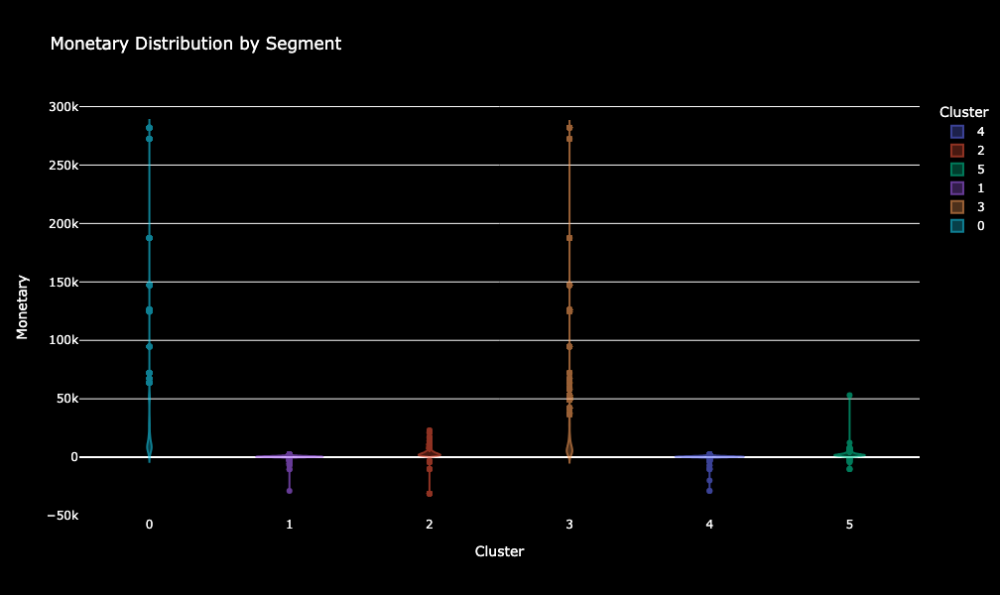

In [46]:
fig_recency_violin = px.violin(rfm, x='Cluster', y='Monetary', color='Cluster', title='Monetary Distribution by Segment')
fig_recency_violin.update_traces(marker=dict(line=dict(color='black')), opacity=0.6)
fig_recency_violin.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig_recency_violin.show()


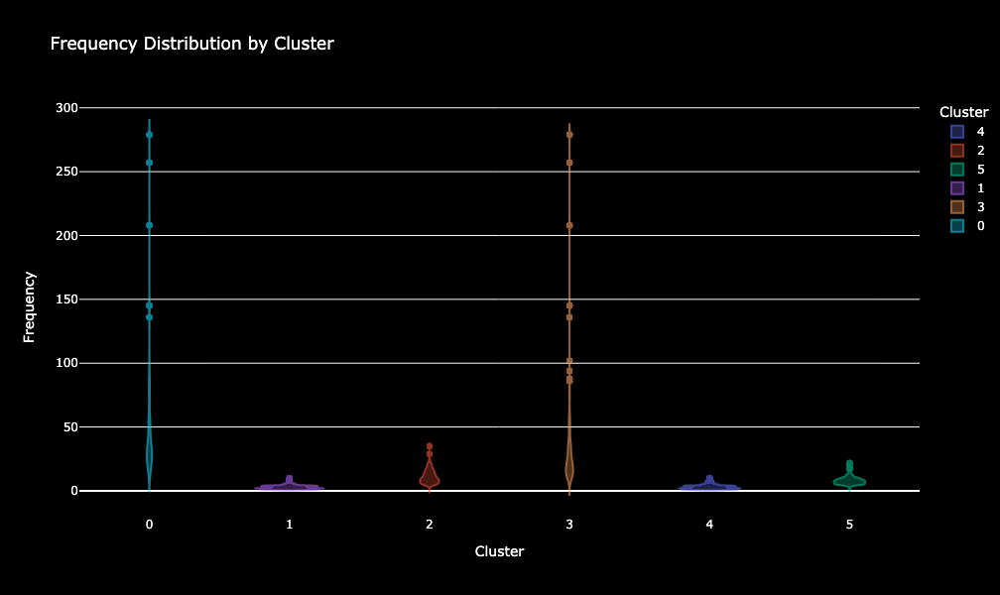

In [47]:
fig_recency_violin = px.violin(rfm, x='Cluster', y='Frequency', color='Cluster', title='Frequency Distribution by Cluster')
fig_recency_violin.update_traces(marker=dict(line=dict(color='black')), opacity=0.6)
fig_recency_violin.update_layout( width=800, height=600,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='white')
)
fig_recency_violin.show()


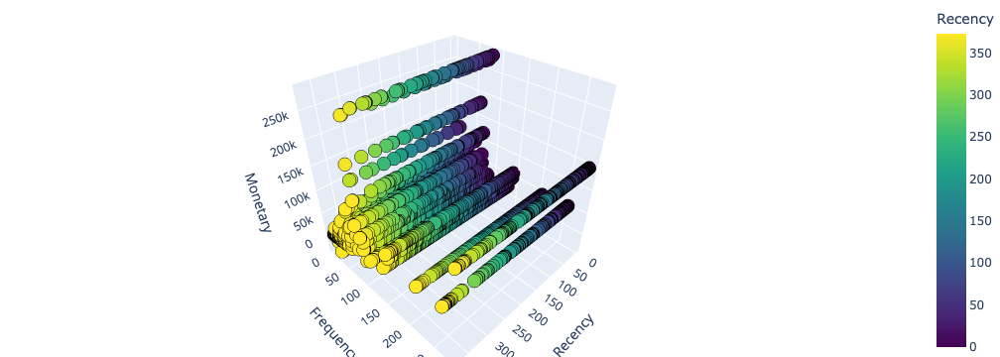

In [48]:
import plotly.graph_objects as go
fig = go.Figure(data=[go.Scatter3d(
    x=rfm['Recency'],
    y=rfm['Frequency'],
    z=rfm['Monetary'],
    mode='markers',
    marker=dict(
        size=8,
        color=rfm['Recency'],  
        colorscale='Viridis',  
        colorbar=dict(title='Recency'),  
        line=dict(color='black', width=0.5)  
    )
)])

fig.update_layout(
    scene=dict(
        xaxis=dict(title='Recency'),
        yaxis=dict(title='Frequency'),
        zaxis=dict(title='Monetary'),
    ),
    margin=dict(l=0, r=0, b=0, t=0),
)

fig.show()


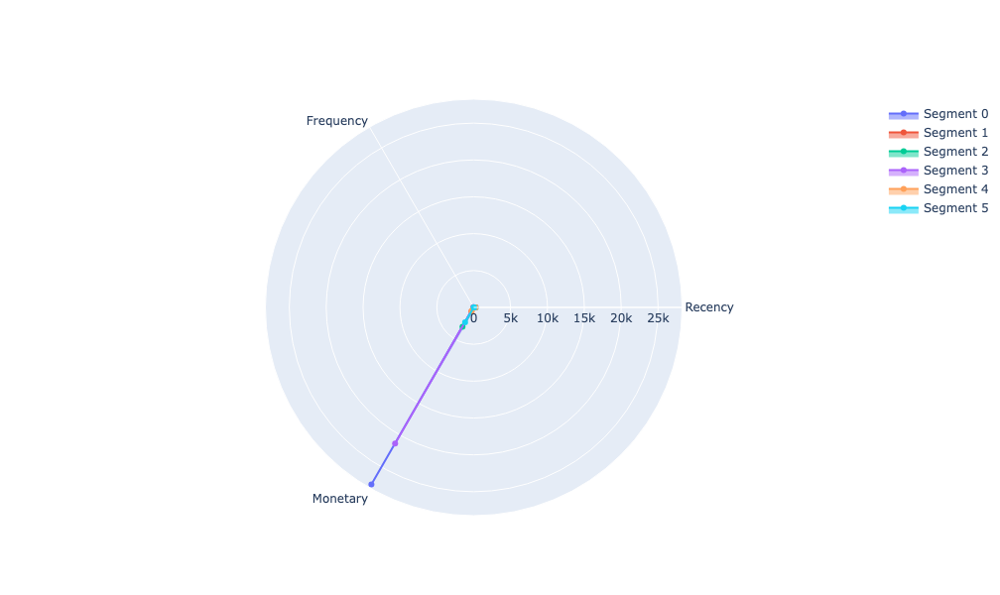

In [49]:
fig = go.Figure()

for segment in segment_profiles['Segment']:
    fig.add_trace(go.Scatterpolar(
        r=segment_profiles[segment_profiles['Segment'] == segment][['Recency', 'Frequency', 'Monetary']].values.flatten(),
        theta=['Recency', 'Frequency', 'Monetary'],
        fill='toself',
        name=f'Segment {segment}'
    ))

fig.update_layout( width=800, height=600,
    polar=dict(radialaxis=dict(visible=True)),
    showlegend=True
)

fig.show()


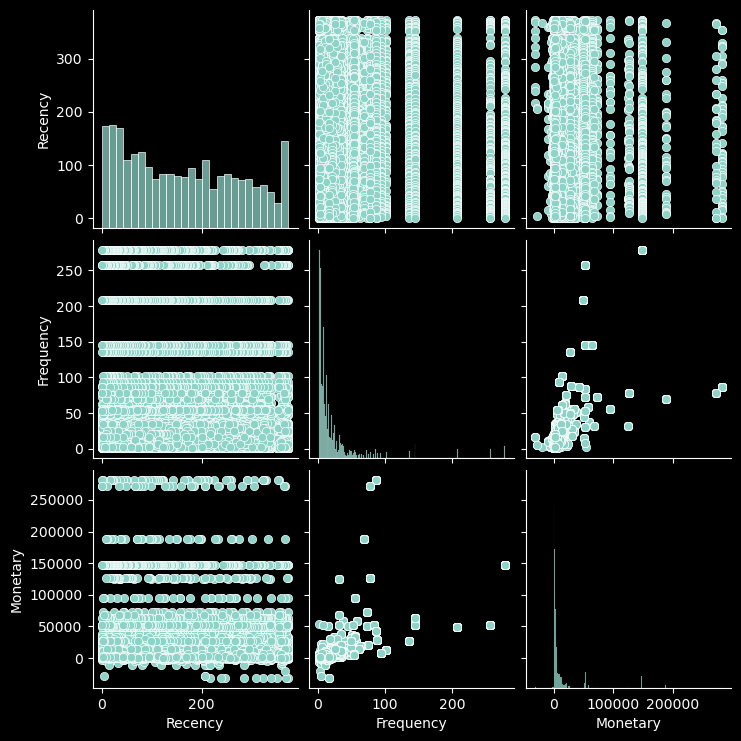

In [50]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.pairplot(rfm[['Recency', 'Frequency', 'Monetary']])
plt.show()


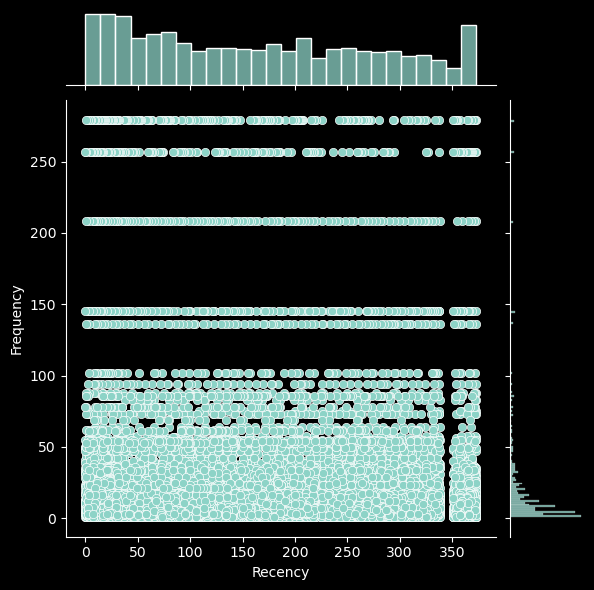

In [51]:
sns.jointplot(x='Recency', y='Frequency', data=rfm, kind='scatter')
plt.show()

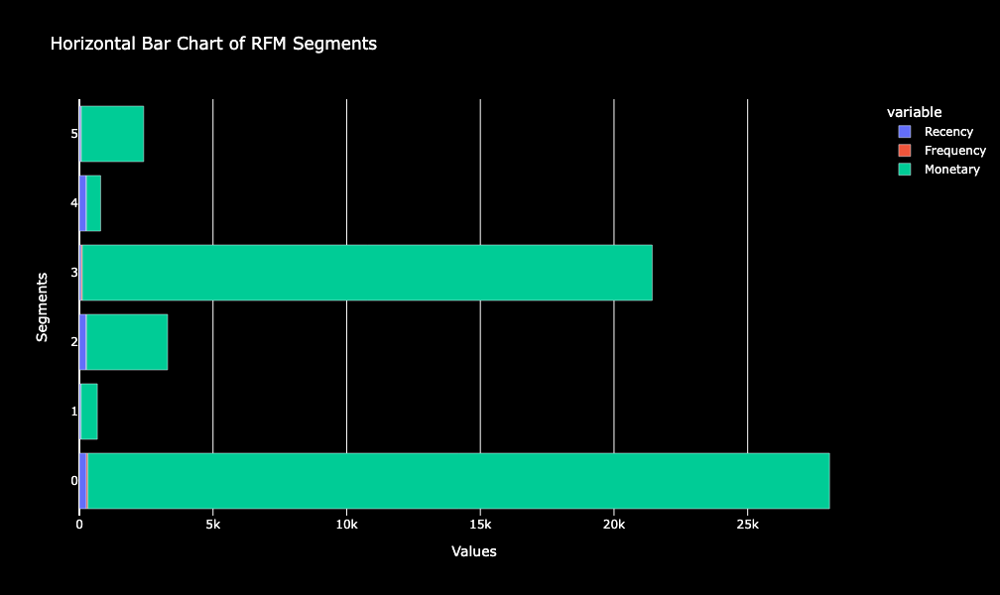

In [52]:
fig = px.bar(segment_profiles, y='Segment', x=['Recency', 'Frequency', 'Monetary'], orientation='h', title='Horizontal Bar Chart of RFM Segments')
fig.update_layout(width=800, height=600,xaxis=dict(title='Values'), yaxis=dict(title='Segments'), plot_bgcolor='black', paper_bgcolor='black', font=dict(color='white'))
fig.show()

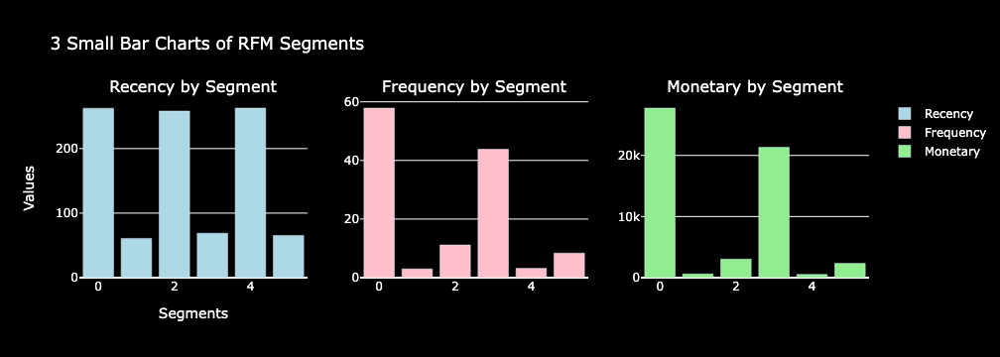

In [53]:
from plotly.subplots import make_subplots

fig = make_subplots(rows=1, cols=3, subplot_titles=('Recency by Segment', 'Frequency by Segment', 'Monetary by Segment'))

colors = ['lightblue', 'pink', 'lightgreen'] 

for i, col in enumerate(['Recency', 'Frequency', 'Monetary']):
    trace = go.Bar(x=segment_profiles['Segment'], y=segment_profiles[col], name=col, marker_color=colors[i])
    fig.add_trace(trace, row=1, col=i+1)

fig.update_layout(title='3 Small Bar Charts of RFM Segments', xaxis=dict(title='Segments'), yaxis=dict(title='Values'), plot_bgcolor='black', paper_bgcolor='black', font=dict(color='white'))
fig.show()

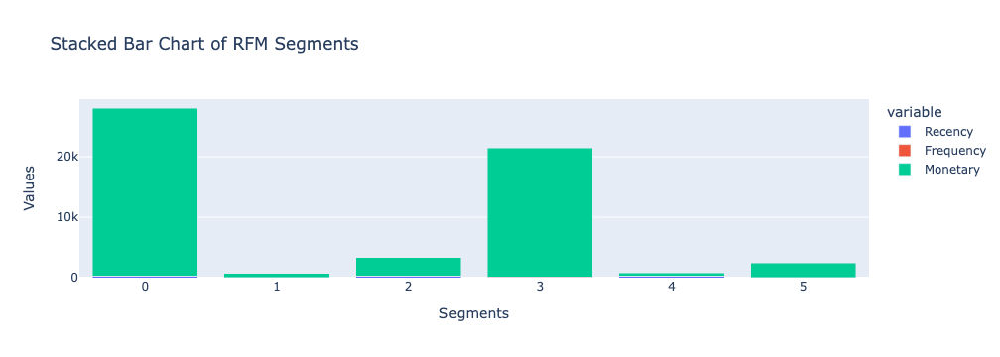

In [54]:
fig = px.bar(segment_profiles, x='Segment', y=['Recency', 'Frequency', 'Monetary'], barmode='stack', title='Stacked Bar Chart of RFM Segments')
fig.update_layout(xaxis=dict(title='Segments'), yaxis=dict(title='Values'))
fig.show()

### SOLUTIONS- 

#### 1. DATA OVERVIEW

##### Q. What is the size of the dataset in terms of the number of rows and columns?

In [55]:
print(data.size)

6502908


We have 6502908 values in the dataset.

In [56]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 12 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   InvoiceNo    541909 non-null  object        
 1   StockCode    541909 non-null  object        
 2   Description  541909 non-null  object        
 3   Quantity     541909 non-null  int64         
 4   InvoiceDate  541909 non-null  object        
 5   UnitPrice    541909 non-null  float64       
 6   CustomerID   541909 non-null  float64       
 7   Country      541909 non-null  object        
 8   Date         541909 non-null  datetime64[ns]
 9   Time         541909 non-null  object        
 10  Recency      541909 non-null  int64         
 11  TotalPrice   541909 non-null  float64       
dtypes: datetime64[ns](1), float64(3), int64(2), object(6)
memory usage: 49.6+ MB


Number of columns - 12

In [57]:
print(len(data))

541909


Number of columns - 541909

##### Q. Can you provide a brief description of each column in the dataset?

In [58]:
data.describe(include='all' , datetime_is_numeric=True)  

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Date,Time,Recency,TotalPrice
count,541909,541909,541909,541909.000000,541909,541909.000000,541909.000000,541909,541909,541909,541909.000000,541909.000000
unique,25900,4070,4224,NaN,23260,NaN,NaN,38,NaN,774,NaN,NaN
top,573585,85123A,WHITE HANGING HEART T-LIGHT HOLDER,NaN,10/31/11 14:41,NaN,NaN,United Kingdom,NaN,15:56,NaN,NaN
freq,1114,2313,2369,NaN,1114,NaN,NaN,495478,NaN,2628,NaN,NaN
mean,NaN,NaN,NaN,9.552250,NaN,4.611114,15272.795237,NaN,2011-07-04 00:00:13.073782272,NaN,157.999849,17.987795
min,NaN,NaN,NaN,-80995.000000,NaN,-11062.060000,12346.000000,NaN,2010-12-01 00:00:00,NaN,0.000000,-168469.600000
25%,NaN,NaN,NaN,1.000000,NaN,1.250000,13798.000000,NaN,2011-03-28 00:00:00,NaN,51.000000,3.400000
50%,NaN,NaN,NaN,3.000000,NaN,2.080000,15145.000000,NaN,2011-07-19 00:00:00,NaN,143.000000,9.750000
75%,NaN,NaN,NaN,10.000000,NaN,4.130000,16803.000000,NaN,2011-10-19 00:00:00,NaN,256.000000,17.400000
max,NaN,NaN,NaN,80995.000000,NaN,38970.000000,18287.000000,NaN,2011-12-09 00:00:00,NaN,373.000000,168469.600000


##### Q. What is the time period covered by this dataset?

In [59]:
df_search=data[data['Date'].notnull()]
start = df_search['Date'].min()
end = df_search['Date'].max()
print(f"start date: {start} ")
print(f"end date: {end}")

start date: 2010-12-01 00:00:00 
end date: 2011-12-09 00:00:00


In [60]:
time_period = end - start

In [61]:
print("The time period covered in this dataset is- \n", time_period)

The time period covered in this dataset is- 
 373 days 00:00:00


#### 2. CUSTOMER ANALYSIS

##### Q. How many unique customers are there in the dataset?

In [62]:
data.groupby('CustomerID')['InvoiceNo'].nunique()

CustomerID
12346.0     2
12347.0     7
12348.0     5
12349.0     1
12350.0     1
           ..
18280.0     6
18281.0     1
18282.0     3
18283.0    16
18287.0     3
Name: InvoiceNo, Length: 4372, dtype: int64

In [63]:
data['CustomerID'].nunique()

4372

There are 4372 unique customers.

##### Q. What is the distribution of the number of orders per customer?

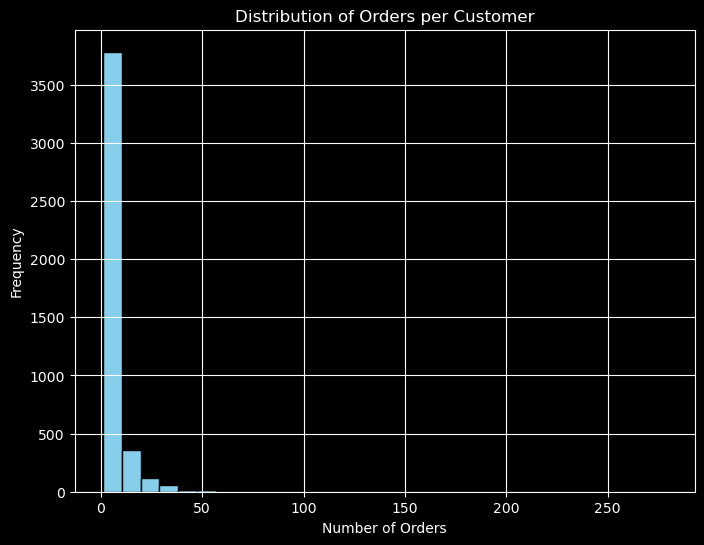

In [64]:
orders_per_customer = data.groupby('CustomerID')['InvoiceNo'].nunique()

plt.figure(figsize=(8, 6))
plt.hist(orders_per_customer, bins=30, color='skyblue', edgecolor='black')
plt.xlabel('Number of Orders')
plt.ylabel('Frequency')
plt.title('Distribution of Orders per Customer')
plt.grid(True)
plt.show()

##### Q. Can you identify the top 5 customers who have made the most purchases by order count?

In [65]:
top_customers = orders_per_customer.sort_values(ascending=False).head(5)
print("Top 5 Customers by Order Count:")
print(top_customers)

Top 5 Customers by Order Count:
CustomerID
14911.0    279
12748.0    257
17841.0    208
13089.0    145
15311.0    145
Name: InvoiceNo, dtype: int64


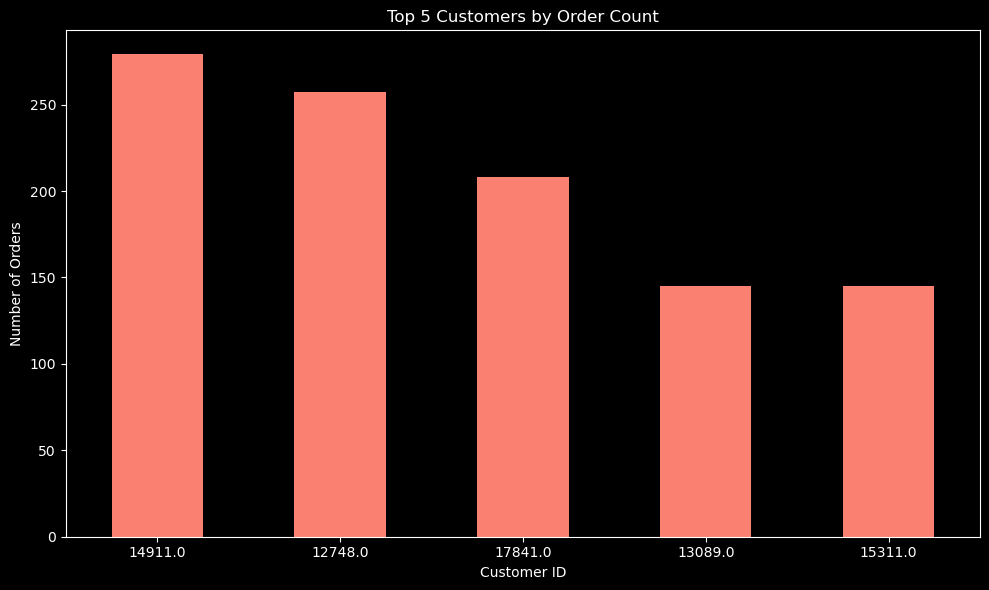

In [66]:

top_5_customers = orders_per_customer.sort_values(ascending=False).head(5)
plt.figure(figsize=(10, 6))
top_5_customers.plot(kind='bar', color='salmon')
plt.title('Top 5 Customers by Order Count')
plt.xlabel('Customer ID')
plt.ylabel('Number of Orders')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


#### 3. PRODUCT ANALYSIS

##### Q. What are the top 10 most frequently purchased products?

In [67]:
top_10_products = data['Description'].value_counts().head(10)
print("Top 10 Most Frequently Purchased Products:")
print(top_10_products)

Top 10 Most Frequently Purchased Products:
WHITE HANGING HEART T-LIGHT HOLDER    2369
REGENCY CAKESTAND 3 TIER              2200
JUMBO BAG RED RETROSPOT               2159
PARTY BUNTING                         1727
LUNCH BAG RED RETROSPOT               1638
ASSORTED COLOUR BIRD ORNAMENT         1501
SET OF 3 CAKE TINS PANTRY DESIGN      1473
Unknown                               1454
PACK OF 72 RETROSPOT CAKE CASES       1385
LUNCH BAG  BLACK SKULL.               1350
Name: Description, dtype: int64


##### Q. What is the average price of products in the dataset?

In [68]:
average_price = data['UnitPrice'].mean()
print("Average Price of Products: {:.2f}".format(average_price))

Average Price of Products: 4.61


##### Q. Can you find out which product category generates the highest revenue?

In [69]:
data['TotalRevenue'] = data['Quantity'] * data['UnitPrice']
highest_revenue_category = data.groupby('Description')['TotalRevenue'].sum().idxmax()
print("\nProduct Category Generating the Highest Revenue: ", highest_revenue_category)


Product Category Generating the Highest Revenue:  DOTCOM POSTAGE


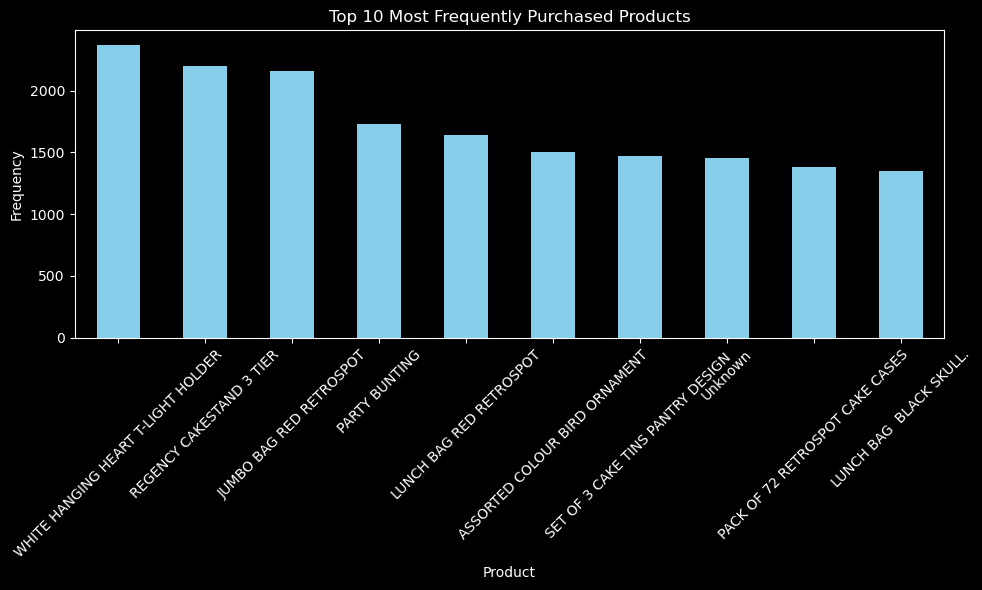

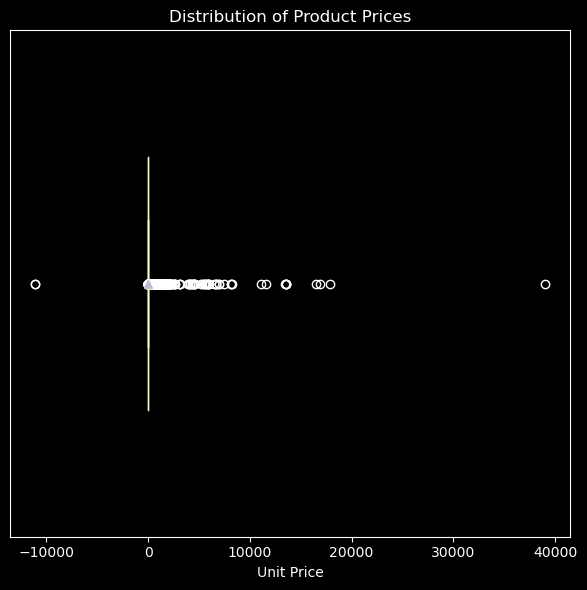

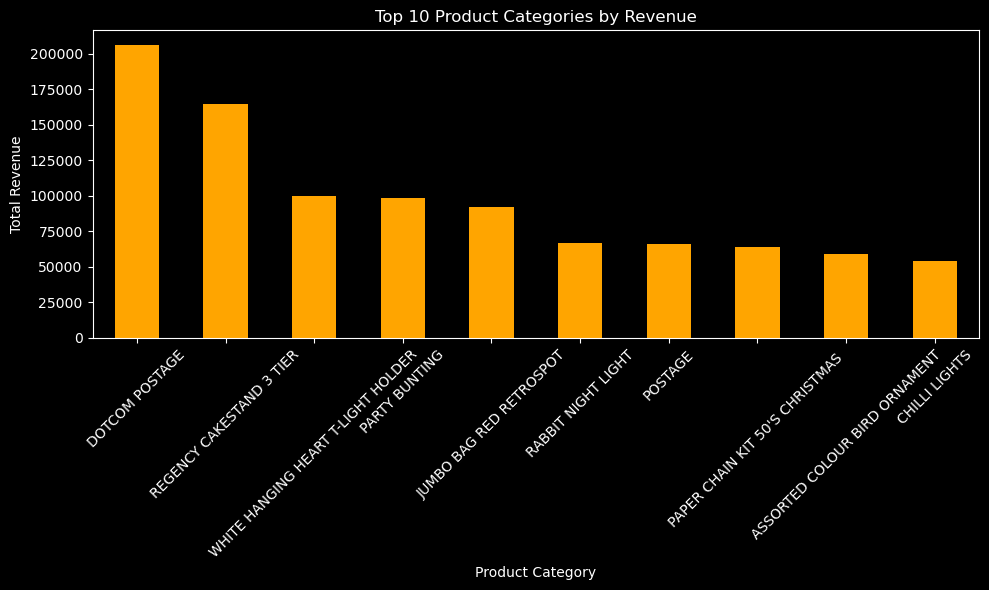

In [70]:
# Top 10 most frequently purchased products
top_10_products = data['Description'].value_counts().head(10)
plt.figure(figsize=(10, 6))
top_10_products.plot(kind='bar', color='skyblue')
plt.title('Top 10 Most Frequently Purchased Products')
plt.xlabel('Product')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Average price of products
plt.figure(figsize=(6, 6))
plt.boxplot(data['UnitPrice'], patch_artist=True, showmeans=True, vert=False, widths=0.5)
plt.title('Distribution of Product Prices')
plt.xlabel('Unit Price')
plt.yticks([])
plt.tight_layout()
plt.show()

# Product category with highest revenue
category_revenue = data.groupby('Description')['TotalRevenue'].sum().nlargest(10)
plt.figure(figsize=(10, 6))
category_revenue.plot(kind='bar', color='orange')
plt.title('Top 10 Product Categories by Revenue')
plt.xlabel('Product Category')
plt.ylabel('Total Revenue')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#### 4. TIME ANALYSIS

##### Q. Is there a specific day of the week or time of day when most orders are placed?

In [71]:
data['InvoiceDate'] = pd.to_datetime(data['InvoiceDate'])

data['DayOfWeek'] = data['InvoiceDate'].dt.day_name()
most_orders_day = data['DayOfWeek'].value_counts().idxmax()
print("Day of the week with the most orders:", most_orders_day)

data['HourOfDay'] = data['InvoiceDate'].dt.hour
most_orders_hour = data['HourOfDay'].value_counts().idxmax()
print("Hour of the day when most orders are placed:", most_orders_hour)

Day of the week with the most orders: Thursday
Hour of the day when most orders are placed: 12


##### Q. What is the average order processing time?

In [72]:
data['OrderProcessingTime'] = data.groupby('InvoiceNo')['InvoiceDate'].transform('max') - data.groupby('InvoiceNo')['InvoiceDate'].transform('min')
average_order_processing_time = data['OrderProcessingTime'].mean()
print("Average Order Processing Time:", average_order_processing_time)

Average Order Processing Time: 0 days 00:00:00.370578824


##### Q. Are there any seasonal trends in the dataset?

In [73]:
data['Month'] = data['InvoiceDate'].dt.to_period('M')
monthly_order_count = data['Month'].value_counts().sort_index()

print("\nMonthly Order Counts:")
print(monthly_order_count)


Monthly Order Counts:
2010-12    42481
2011-01    35147
2011-02    27707
2011-03    36748
2011-04    29916
2011-05    37030
2011-06    36874
2011-07    39518
2011-08    35284
2011-09    50226
2011-10    60742
2011-11    84711
2011-12    25525
Freq: M, Name: Month, dtype: int64


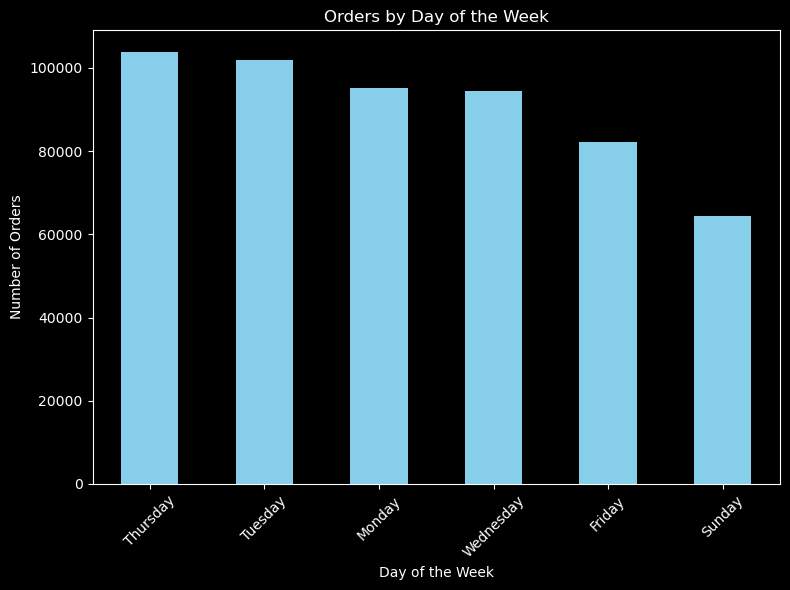

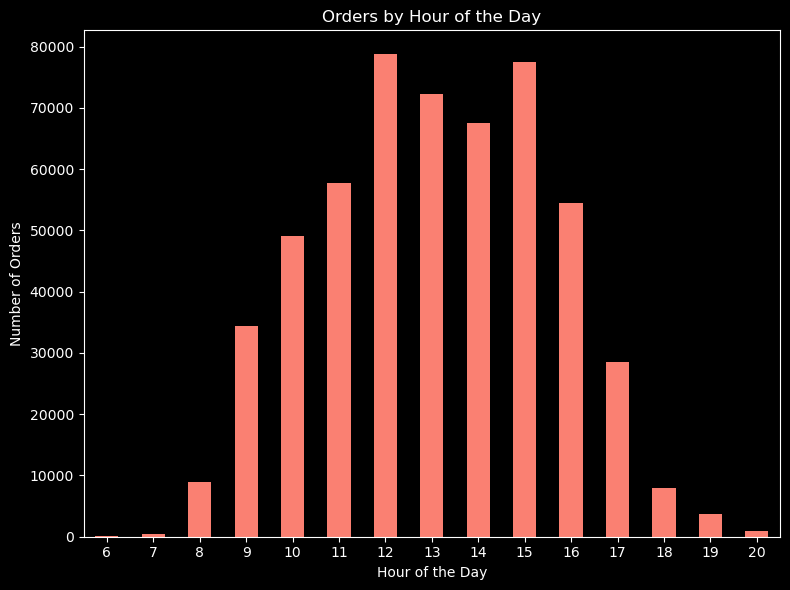

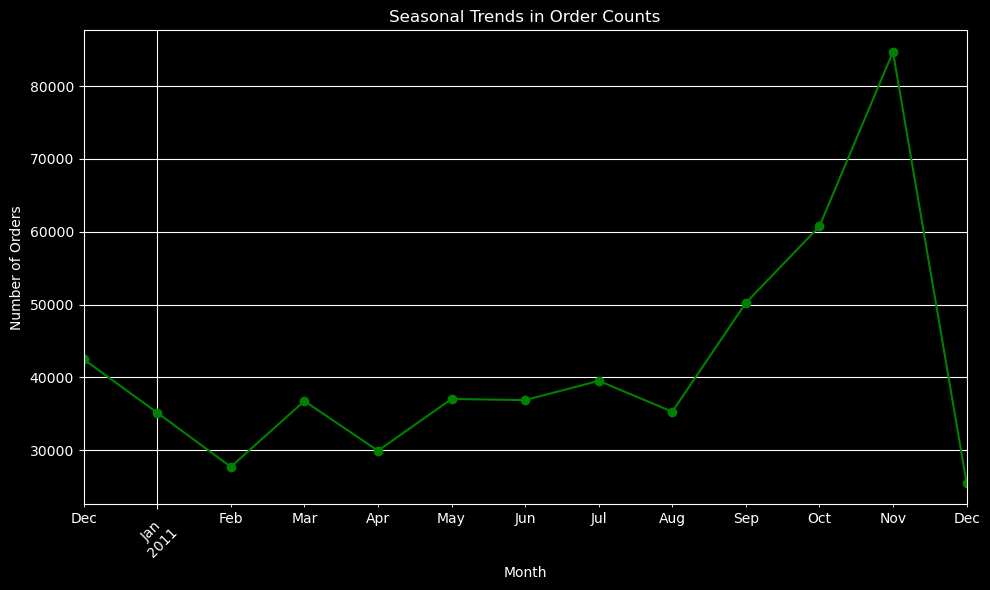

In [74]:
# Day of the week with the most orders
plt.figure(figsize=(8, 6))
data['DayOfWeek'].value_counts().plot(kind='bar', color='skyblue')
plt.xlabel('Day of the Week')
plt.ylabel('Number of Orders')
plt.title('Orders by Day of the Week')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Hour of the day when most orders are placed 
plt.figure(figsize=(8, 6))
data['HourOfDay'].value_counts().sort_index().plot(kind='bar', color='salmon')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Orders')
plt.title('Orders by Hour of the Day')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

# Seasonal Trends 
plt.figure(figsize=(10, 6))
monthly_order_count.plot(kind='line', marker='o', color='green')
plt.xlabel('Month')
plt.ylabel('Number of Orders')
plt.title('Seasonal Trends in Order Counts')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()


#### 5. Geographical Analysis

##### Q. Can you determine the top 5 countries with the highest number of orders?

In [75]:
top_5_countries_orders = data['Country'].value_counts().head(5)
print("Top 5 Countries by Order Count:")
print(top_5_countries_orders)

Top 5 Countries by Order Count:
United Kingdom    495478
Germany             9495
France              8557
EIRE                8196
Spain               2533
Name: Country, dtype: int64


##### Q.  Is there a correlation between the country of the customer and the average order value?

In [76]:
from scipy.stats import f_oneway
avg_order_values = data.groupby('Country')['UnitPrice'].mean()
result_anova = f_oneway(*[data['UnitPrice'][data['Country'] == country] for country in data['Country'].unique()])

print("ANOVA Test p-value:", result_anova.pvalue)

ANOVA Test p-value: 3.5817635058736703e-47


The p-value obtained from the ANOVA test is extremely low (3.58e-47), shows that it is a highly significant result. The low p-value shows that there are statistically significant differences in average order values among different countries.

Based on the ANOVA test results, we can conclude that there is a correlation between the country of the customer and the average order value. The variation in average order values across various countries is not due to random chance, instead, it suggests that the country of the customer influences the average order value significantly.

This information implies that customers from different countries tend to have varying average spending habits or purchase behaviors, leading to differences in the average value of orders placed by customers from different geographical locations.

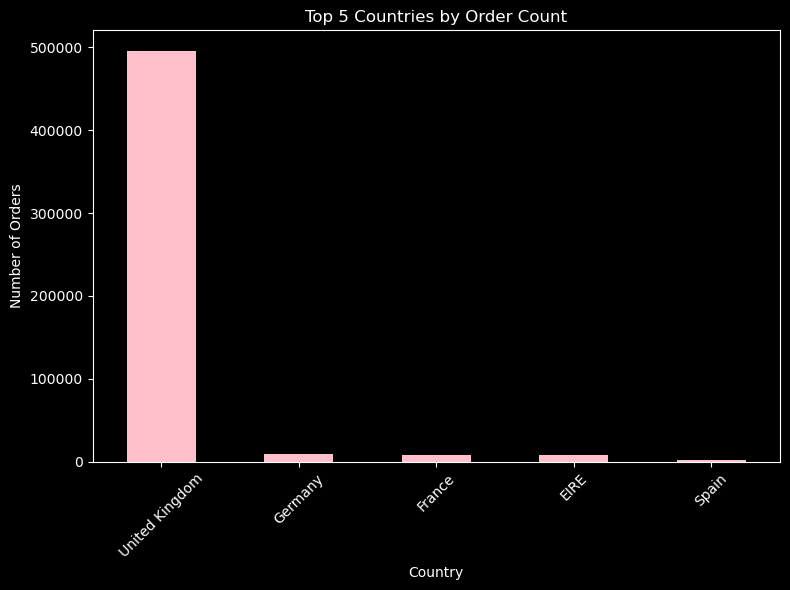

In [77]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
top_5_countries_orders.plot(kind='bar', color='pink')
plt.xlabel('Country')
plt.ylabel('Number of Orders')
plt.title('Top 5 Countries by Order Count')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

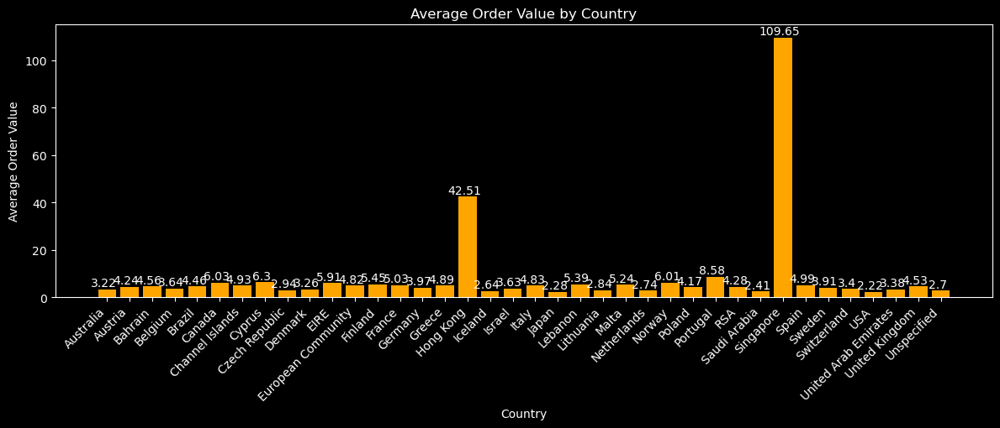

In [78]:

avg_order_value = data.groupby('Country')['UnitPrice'].mean()

plt.figure(figsize=(12, 6))
bars = plt.bar(avg_order_value.index, avg_order_value.values, color='orange')

plt.xlabel('Country')
plt.ylabel('Average Order Value')
plt.title('Average Order Value by Country')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

plt.subplots_adjust(bottom=0.4)
for bar in bars:
    plt.text(bar.get_x() + bar.get_width() / 2 - 0.15, bar.get_height() + 0.2,
             round(bar.get_height(), 2), ha='center', va='bottom')

plt.show()


#### 6. Payment Analysis

##### Q. What are the most common payment methods used by customers? 

## There is no payment method mentioned in the database. We will be adding a new column for the payment methods, for the sake of analysis.

In [79]:
import random
payment_methods = ['Cash', 'Card', 'Cryptocurrency', 'Mobile Wallet', 'Bank Transfer']
data['PaymentMethod'] = [random.choice(payment_methods) for _ in range(len(data))]

In [80]:
common_payment_methods = data['PaymentMethod'].value_counts()
print("Most Common Payment Methods:")
print(common_payment_methods)

Most Common Payment Methods:
Cash              108564
Bank Transfer     108510
Mobile Wallet     108435
Cryptocurrency    108370
Card              108030
Name: PaymentMethod, dtype: int64


##### Q. Is there a relationship between the payment method and the order amount?

In [81]:
payment_order_amount = data.groupby('PaymentMethod')['UnitPrice'].mean()
print("\nMean Order Amount per Payment Method:")
print(payment_order_amount)



Mean Order Amount per Payment Method:
PaymentMethod
Bank Transfer     4.439228
Card              5.230973
Cash              4.510574
Cryptocurrency    4.161268
Mobile Wallet     4.715809
Name: UnitPrice, dtype: float64


In [82]:
from scipy.stats import f_oneway
bank_transfer = data[data['PaymentMethod'] == 'Bank Transfer']['UnitPrice']
card = data[data['PaymentMethod'] == 'Card']['UnitPrice']
cash = data[data['PaymentMethod'] == 'Cash']['UnitPrice']
cryptocurrency = data[data['PaymentMethod'] == 'Cryptocurrency']['UnitPrice']
mobile_wallet = data[data['PaymentMethod'] == 'Mobile Wallet']['UnitPrice']

f_statistic, p_value = f_oneway(bank_transfer, card, cash, cryptocurrency, mobile_wallet)
print("ANOVA Test p-value:", p_value)


ANOVA Test p-value: 0.11793511552775524


A p-value of 0.60 from the ANOVA test suggests that there isn't strong evidence to reject the null hypothesis. In this case, with a higher p-value (greater than the typical significance level of 0.05), it indicates that there may not be significant differences in mean order amounts between the payment methods.

Therefore, based on this analysis, there might not be a statistically significant relationship between the payment method and the order amount.

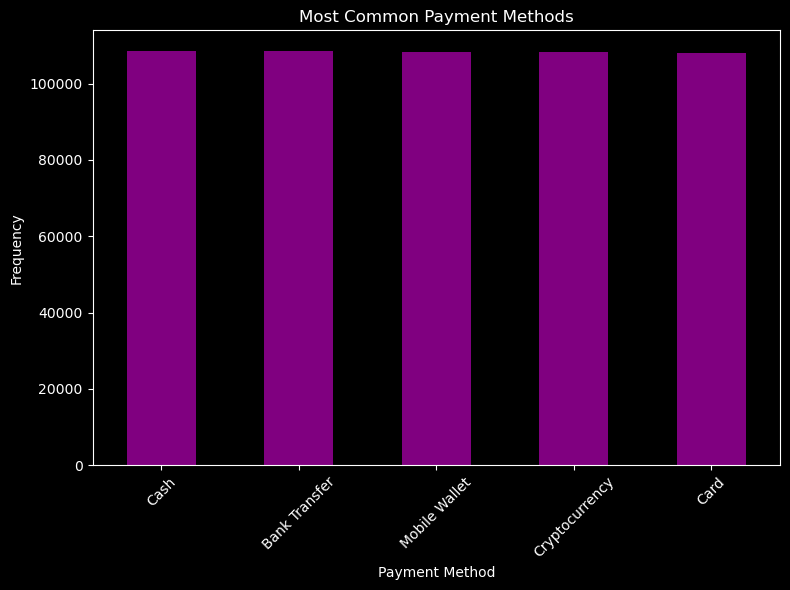

In [83]:
payment_counts = data['PaymentMethod'].value_counts()

plt.figure(figsize=(8, 6))
payment_counts.plot(kind='bar', color='purple')
plt.xlabel('Payment Method')
plt.ylabel('Frequency')
plt.title('Most Common Payment Methods')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

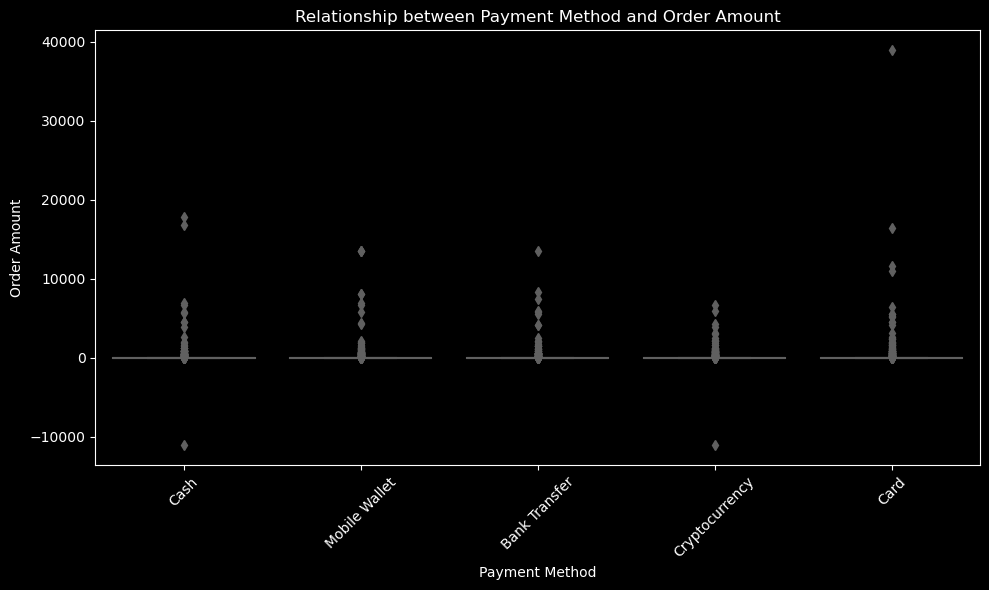

In [84]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='PaymentMethod', y='UnitPrice', data=data, palette='coolwarm')
plt.xlabel('Payment Method')
plt.ylabel('Order Amount')
plt.title('Relationship between Payment Method and Order Amount')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#### 7. CUSTOMER BEHAVIOUR

##### Q. How long, on average, do customers remain active (between their first and last purchase)?

In [85]:
customer_activity = data.groupby('CustomerID')['InvoiceDate'].agg(['min', 'max'])
customer_activity['ActivityDuration'] = (customer_activity['max'] - customer_activity['min']).dt.days

average_activity_duration = customer_activity['ActivityDuration'].mean()
print("Average time for which the customers remain active:", average_activity_duration, "days")


Average time for which the customers remain active: 133.38677950594695 days


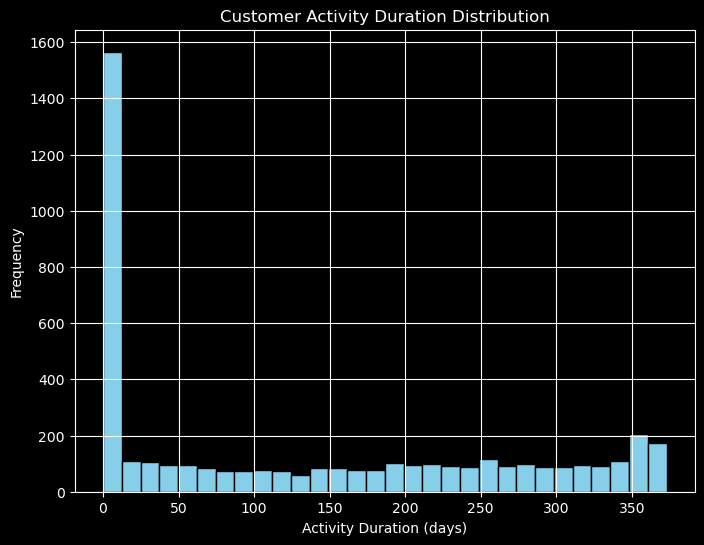

In [86]:
plt.figure(figsize=(8, 6))
plt.hist(customer_activity['ActivityDuration'], bins=30, color='skyblue', edgecolor='black')
plt.xlabel('Activity Duration (days)')
plt.ylabel('Frequency')
plt.title('Customer Activity Duration Distribution')
plt.grid(True)
plt.show()

#### 8. RETURNS AND REFUNDS

### There is no RETURN/REFUND and product category mentioned in the database. We will be adding a new column for the sake of analysis.

In [87]:
data['ReturnRefund'] = np.random.choice(['Return', 'Refund', 'None', 'Null', 'No', ' '], size=len(data))

product_descriptions = [
    'Stylish backpack', 'Antique vase', 'Modern lamp', 'Designer chair', 'Vintage clock', 'Bottle' ]
data['ProductDescription'] = np.random.choice(product_descriptions, size=len(data))

print(data.head())

  InvoiceNo StockCode                          Description  Quantity  \
0    536365    85123A   WHITE HANGING HEART T-LIGHT HOLDER         6   
1    536365     71053                  WHITE METAL LANTERN         6   
2    536365    84406B       CREAM CUPID HEARTS COAT HANGER         8   
3    536365    84029G  KNITTED UNION FLAG HOT WATER BOTTLE         6   
4    536365    84029E       RED WOOLLY HOTTIE WHITE HEART.         6   

          InvoiceDate  UnitPrice  CustomerID         Country       Date  Time  \
0 2010-12-01 08:26:00       2.55     17850.0  United Kingdom 2010-12-01  8:26   
1 2010-12-01 08:26:00       3.39     17850.0  United Kingdom 2010-12-01  8:26   
2 2010-12-01 08:26:00       2.75     17850.0  United Kingdom 2010-12-01  8:26   
3 2010-12-01 08:26:00       3.39     17850.0  United Kingdom 2010-12-01  8:26   
4 2010-12-01 08:26:00       3.39     17850.0  United Kingdom 2010-12-01  8:26   

   Recency  TotalPrice  TotalRevenue  DayOfWeek  HourOfDay  \
0      373       1

##### Q. What is the percentage of orders that have experienced returns or refunds?

In [88]:
total_orders = len(data)
orders_with_returns = len(data[data['ReturnRefund'] == 'Return']) + len(data[data['ReturnRefund'] == 'Refund'])
percentage_return_orders = (orders_with_returns / total_orders) * 100

print(f"Percentage of orders with returns or refunds: {percentage_return_orders:.2f}%")


Percentage of orders with returns or refunds: 33.23%


##### Q. Is there a correlation between the product category and the likelihood of returns?

In [89]:
return_by_category = data.groupby('ProductDescription')['ReturnRefund'].value_counts(normalize=True).unstack().fillna(0)
print(return_by_category[['Return', 'Refund']])

ReturnRefund          Return    Refund
ProductDescription                    
Antique vase        0.165757  0.166308
Bottle              0.163853  0.168639
Designer chair      0.165812  0.165690
Modern lamp         0.166870  0.166737
Stylish backpack    0.163932  0.165959
Vintage clock       0.167650  0.166510


In [90]:
from scipy.stats import chi2_contingency

chi2, p, _, _ = chi2_contingency(return_by_category[['Return', 'Refund']])
print(f"Chi-square statistic: {chi2}")
print(f"P-value: {p}")

Chi-square statistic: 6.83771175307887e-05
P-value: 0.9999999999979435


The obtained p-value from the chi-square test is close to 1. This high p-value suggests strong evidence that there is no significant association between the product categories and the likelihood of returns. In other words, based on the data analyzed, it doesn't appear that different product categories have a notable impact on the likelihood of returns.

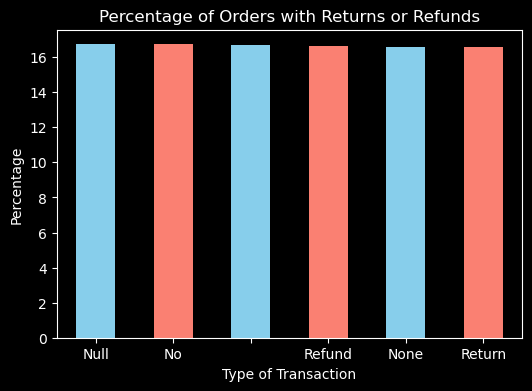

In [91]:
return_refund_percentage = data['ReturnRefund'].value_counts(normalize=True) * 100

plt.figure(figsize=(6, 4))
return_refund_percentage.plot(kind='bar', color=['skyblue', 'salmon'])
plt.xlabel('Type of Transaction')
plt.ylabel('Percentage')
plt.title('Percentage of Orders with Returns or Refunds')
plt.xticks(rotation=0)
plt.show()

#### 9. Profitability Analysis

##### Q. Can you calculate the total profit generated by the company during the dataset's time period?

In [92]:
data['TotalCost'] = data['Quantity'] * data['UnitPrice']
total_profit = data['TotalCost'].sum()
data['Profit'] = data['TotalCost'] - data['UnitPrice']
print("Total Profit:", total_profit)

Total Profit: 9747747.933999998


##### Q. What are the top 5 products with the highest profit margins?

In [93]:
data['ProfitMargin'] = (data['Profit'] / data['TotalCost']) * 100

profit_per_product = data.groupby('ProductDescription')['Profit'].sum().sort_values(ascending=False)

top_5_profitable_products = data.groupby('ProductDescription')['ProfitMargin'].mean().nlargest(5)
print("Top 5 products with highest profit margins:")
print(top_5_profitable_products)

Top 5 products with highest profit margins:
ProductDescription
Vintage clock       58.091086
Designer chair      58.037085
Modern lamp         57.998625
Stylish backpack    57.939480
Bottle              57.938640
Name: ProfitMargin, dtype: float64


#### 10. CUSTOMER SATISFACTION

### There is no customer feedback mentioned in the database. We will be adding a new column for the sake of analysis.

##### Q. Is there any data available on customer feedback or ratings for products or services?

In [95]:
additional_comments = [
    "Fantastic product quality!",
    "Disappointed with the late delivery.",
    "Very satisfied with the service.",
    "The product exceeded my expectations.",
    "Unhappy with the customer service response.",
    "Superb packaging, arrived safely.",
    "The item doesn't match the description.",
    "Smooth transaction, thank you!",
    "Appreciate the quick resolution to my issue.",
    "Impressed with the product's durability.",
    "Terrible experience, won't purchase again.",
    "Efficient and reliable service.",
    "The product is exactly what I needed.",
    "Poorly packaged, item arrived damaged.",
    "Thrilled with the purchase!",
    "Customer support was extremely helpful.",
    "The item is of high quality.",
    "Average experience, nothing extraordinary.",
    "Highly dissatisfied with the purchase.",
    "Excellent value for money!",
    "Product arrived earlier than expected, great service!",
    "Not as described, quite misleading.",
    "Overall, satisfied with the purchase.",
    "The product quality doesn't justify the price.",
    "Had issues with the payment process.",
    "Highly recommended, top-notch quality.",
    "The customer service team was very responsive.",
    "Disappointed with the lack of variety in the selection.",
    "Absolutely love the product, will buy again!",
    "Received the wrong item, frustrating experience.",
    "Great value for money, excellent deal!",
    "Seamless checkout process, very convenient.",
    "The product is exactly what I was looking for.",
    "Poor communication regarding shipping updates.",
    "The packaging was secure, item arrived in perfect condition.",
    "Average service, nothing exceptional.",
    "The product durability is questionable.",
    "Issues with the return policy, quite rigid.",
    "Fantastic experience, highly impressed!",
    "Not happy with the after-sales service.",
    "Impressed with the prompt delivery.",
    "Expected better quality, somewhat disappointed.",
    "Excellent customer support, very helpful.",
    "The item was a great addition to my collection.",
    "The delivery process needs improvement.",
    "Pleased with the overall experience.",
    "Product is overpriced for the quality provided.",
    "Great customer service, they resolved my query quickly.",
    "Item received didn't match the image on the website.",
    "The product met my expectations.",
]

additional_comments.extend(additional_comments)
data['CustomerFeedback'] = np.random.choice(additional_comments, size=len(data))

Performing sentimental analysis-

In [97]:
pip install textblob

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [98]:
from textblob import TextBlob
feedback = data['CustomerFeedback']
sentiment_scores = feedback.apply(lambda x: TextBlob(str(x)).sentiment.polarity)

positive_sentiment = sentiment_scores[sentiment_scores > 0].count()
negative_sentiment = sentiment_scores[sentiment_scores < 0].count()
neutral_sentiment = sentiment_scores[sentiment_scores == 0].count()

print("Number of positive sentiments:", positive_sentiment)
print("Number of negative sentiments:", negative_sentiment)
print("Number of neutral sentiments:", neutral_sentiment)

Number of positive sentiments: 303482
Number of negative sentiments: 119429
Number of neutral sentiments: 118998


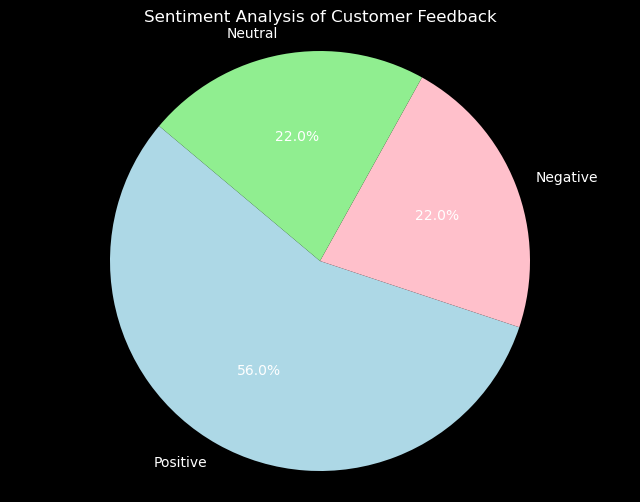

In [99]:
sentiment_labels = ['Positive', 'Negative', 'Neutral']
sentiment_counts = [positive_sentiment, negative_sentiment, neutral_sentiment]
colors = ['lightblue', 'pink', 'lightgreen']

plt.figure(figsize=(8, 6))
plt.pie(sentiment_counts, labels=sentiment_labels, colors=colors, autopct='%1.1f%%', startangle=140)
plt.title('Sentiment Analysis of Customer Feedback')
plt.axis('equal')  
plt.show()
